# Welcome to the Tutorial series for using the Materials Simulation Toolkit for Machine Learning (MAST-ML)!

## MAST-ML is an open-source python package designed to broaden and accelerate the use of machine learning methods in materials science

## Github: https://github.com/uw-cmg/MAST-ML
## Paper Citation: https://doi.org/10.1016/j.commatsci.2020.109544

# Table of Contents
## 1. [Tutorial 1: Getting Started with MAST-ML](#tutorial1)
## 2. [Tutorial 2: Data Import and Cleaning with MAST-ML](#tutorial2)
## 3. [Tutorial 3: Feature Engineering with MAST-ML](#tutorial3)
## 4. [Tutorial 4: Models and Data Splitting Tests with MAST-ML](#tutorial4)
## 5. [Tutorial 5: Left out data, nested cross valiation, and optimized models with MAST-ML](#tutorial5)
## 6. [Tutorial 6: Model error analysis and uncertainty quantification with MAST-ML](#tutorial6)

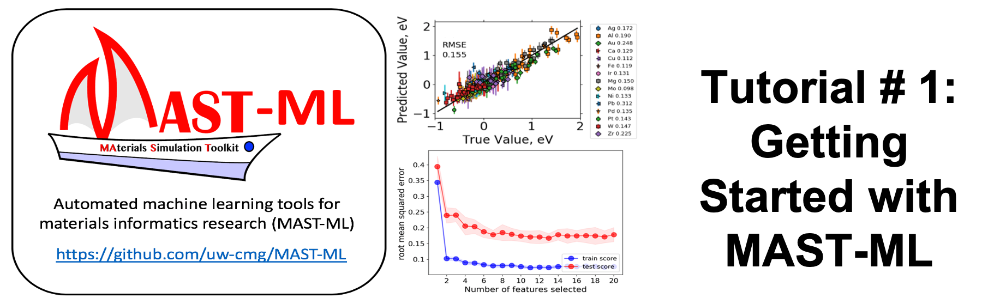

# Tutorial 1: Getting Started with MAST-ML <a name="tutorial1"></a>

## In this first tutorial, we will perform a first, basic run where we: 

1.1. [Set up MAST-ML on Colab and begin session](#task11)

1.2. [Import example data of Boston housing prices](#task12)

1.3. [Define a data preprocessor to normalize the data](#task13)

1.4. [Define a linear regression model and kernel ridge model to fit the data](#task14)

1.5. [Evaluate each of our models with 5-fold cross validation](#task15)

1.6. [Add a random forest model to our run and compare model performance](#task16)


## Task 1.1: Set up MAST-ML on Colab and begin session <a name="task11"></a>

If you are working on Google Colab and need to install MAST-ML, 
begin by cloning the relevant branch of MAST-ML to the Colab session
and install the needed dependencies:

Note that if you are running this tutorial on Nanohub, MAST-ML has already been installed in the shared python environment, so you can skip this install step

In [4]:
!pip install mastml 

  Using cached https://files.pythonhosted.org/packages/cf/40/e094142e31fee2cdb86e7ac6676bdc023917d811f870a7969724c5984e41/mastml-3.0.0-py3-none-any.whl
     |████████████████████████████████| 3.0MB 19.4MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 51kB 5.3MB/s 
     |████████████████████████████████| 81kB 11.6MB/s 
     |████████████████████████████████| 61kB 9.4MB/s 
     |████████████████████████████████| 92kB 12.7MB/s 
     |████████████████████████████████| 5.8MB 20.2MB/s 
     |████████████████████████████████| 102kB 14.7MB/s 
     |████████████████████████████████| 296kB 46.8MB/s 
     |████████████████████████████████| 13.2MB 46.5MB/s 
     |████████████████████████████████| 256kB 47.5MB/s 
     |████████████████████████████████| 71kB 11.1MB/s 
     |████████████████████████████████| 102kB 14.1MB/s 
     |███████

If you are working on Colab, sync your Google drive to Colab so that we can save MAST-ML results to our Google
Drive. If we save to the Colab session, the data will be deleted when the session 
ends.

If you are on Nanohub, you can skip this step as the results of your MAST-ML runs will be saved in your container directory

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


Here we import the MAST-ML modules used in this tutorial

In [1]:
from mastml.mastml import Mastml
from mastml.datasets import SklearnDatasets
from mastml.preprocessing import SklearnPreprocessor
from mastml.models import SklearnModel
from mastml.data_splitters import SklearnDataSplitter

ModuleNotFoundError: No module named 'mastml'

Here, we set the name of the savepath to save MAST-ML results to, and initialize
our MAST-ML run

When the above command is run, a new folder with the name designated SAVEPATH is created.
This is where all of the output for the current MAST-ML run will be saved to.
Note that you can perform multiple runs with the same folder name, and the current datetime
will be appended to the name so that no data is lost or overwritten.

In [3]:
SAVEPATH = 'drive/MyDrive/MASTML_tutorial_1_GettingStarted'

mastml = Mastml(savepath=SAVEPATH)
savepath = mastml.get_savepath

## Task 1.2: Import example data of Boston housing prices <a name="task12"></a>

Here, we use the SklearnDatasets module to load in the data used in this tutorial.
In this tutorial, we examine the model dataset of Boston housing prices.

In [4]:
X, y = SklearnDatasets(as_frame=True).load_boston()

Let's quickly examine the X data so we know what we're dealing with:

In [5]:
X

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.1,2.4786,1.0,273.0,21.0,391.99,9.67
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.7,2.2875,1.0,273.0,21.0,396.90,9.08
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.0,2.1675,1.0,273.0,21.0,396.90,5.64
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.3,2.3889,1.0,273.0,21.0,393.45,6.48


We have 506 data points (houses) and 13 columns (features). The features aren't the
most straightforward to discern at first glance, but they include data such as square footage, age, zoning
area, etc.

From looking at the y-data, we see that the target data are home prices, in thousands. This
data is from a while ago, which is why the prices are so low by today's standards

In [6]:
y

,MEDV
0,24.0
1,21.6
2,34.7
3,33.4
4,36.2
...,...
501,22.4
502,20.6
503,23.9
504,22.0


## Task 1.3: Define a data preprocessor to normalize the data <a name="task13"></a>

This data set already has a set of 13 features, so we don't need to generate
any more for the purposes of this example. However, we do want to normalize 
our data for improved model fitting. Here, we define our preprocessing function. 
We are just going to use the basic StandardScaler in scikit-learn to normalize 
each column to have mean zero and standard deviation of one.

In [7]:
preprocessor = SklearnPreprocessor(preprocessor='StandardScaler', as_frame=True)

## Task 1.4: Define a linear regression model and kernel ridge model to fit the data <a name="task14"></a>

Now we need to decide what types of models to fit to the Boston housing data.
Here, we define two models. The first is a basic linear regression model, and
the second is a kernel ridge model with Gaussian kernel. The scikit-learn model name can 
just be given as a string matching the model name in the "model" field. 
The remaining arguments are the parameters to pass to the model. If no parameters 
are given, default values are used.

In [8]:
model1 = SklearnModel(model='LinearRegression')
model2 = SklearnModel(model='KernelRidge', kernel='rbf')

MAST-ML takes a list of the models as input:

In [9]:
models = [model1, model2]

## Task 1.5: Evaluate each of our models with 5-fold cross validation <a name="task15"></a>

The heart of any MAST-ML run is evaluating the chosen features and model on particular
subsets of the data. Here, we will do a basic example of running a random 
leave-out cross validation test (5-fold CV). MAST-ML will output data and plots
for each split as well as some more comprehensive analysis performed over all
splits. The saved model and preprocessor corresponding to the best split will
also be put in the split directory, which can be imported for use in future
predictions 

In [10]:
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=models,
                  mastml=mastml,
                  preprocessor=preprocessor,
                  savepath=savepath,
                  verbosity=3)

Now that the MAST-ML run has completed, you can check the contents of the output folder.
You'll see that two new folders were made inside of it. They are:

     1.) LinearRegression_RepeatedKFold_SklearnPreprocessor

     2.) KernelRidge_RepeatedKFold_SklearnPreprocessor

At the top level of each of these folders, you will see a number of .xlsx data files and analysis
image files. Examine the data plot named 'parity_plot_test.png' for each model
folder. This plot displays the true vs predicted values for all test data. 


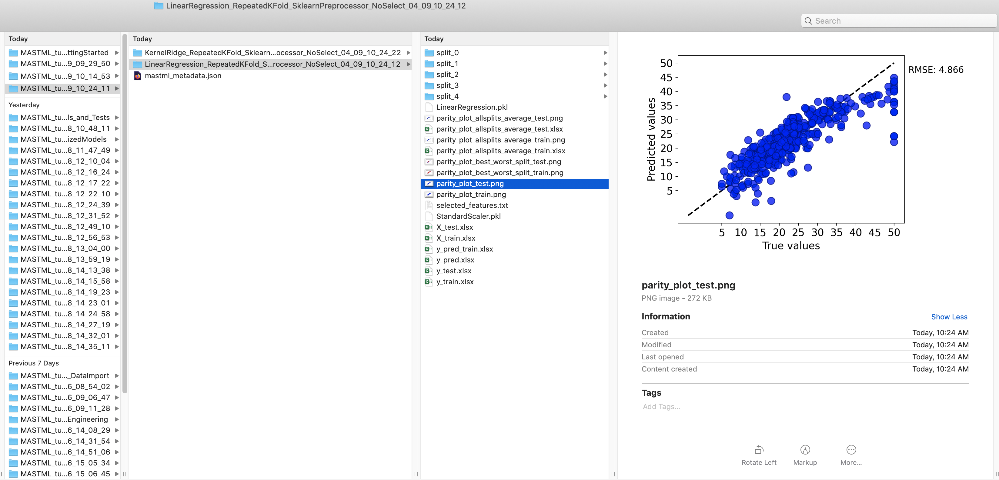

As you can see from the directory structure, MAST-ML saves output for each split performed. 
Looking in one of these split folders, we can see there are a number of data files, including
the train and test data (before and after preprocessing), the calculated residuals on train and
test data, parity plots showing graphically the model performance on train and test data, and 
the saved model and preprocessor files (in .pkl format).

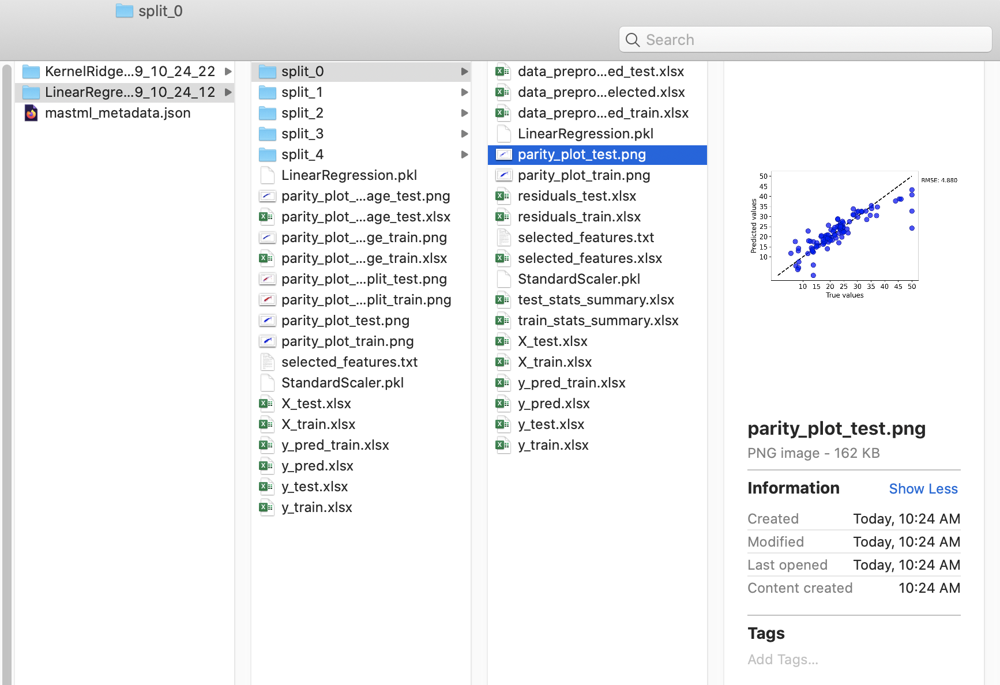

## Task 1.6: Add a random forest model to our run and compare model performance <a name="task16"></a>

Since MAST-ML is now run in a notebook environment, you can go back and add new models, preprocessors, or even
add new features to your data and re-run the above defined data splitter. Similar as with the main save directory,
the data splitter directory names with have the current datetime appended to their base names to prevent data loss.

Here, let's suppose we want to check how a random forest model would perform on our data. Let's make the random forest model then execute the same 5-fold cross validation routine we did on the linear regression and kernel ridge models:

In [11]:
model3 = SklearnModel(model='RandomForestRegressor')
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model3],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  savepath=savepath,
                  verbosity=3)

We can now see that the random forest analysis folder has been added to our main MAST-ML save path. Which of our models performed the best? Parity plots of true vs. predicted values on the test data from cross validation are shown below. It looks like the random forest model has the lowest RMSE!

## Linear model test data parity plot:
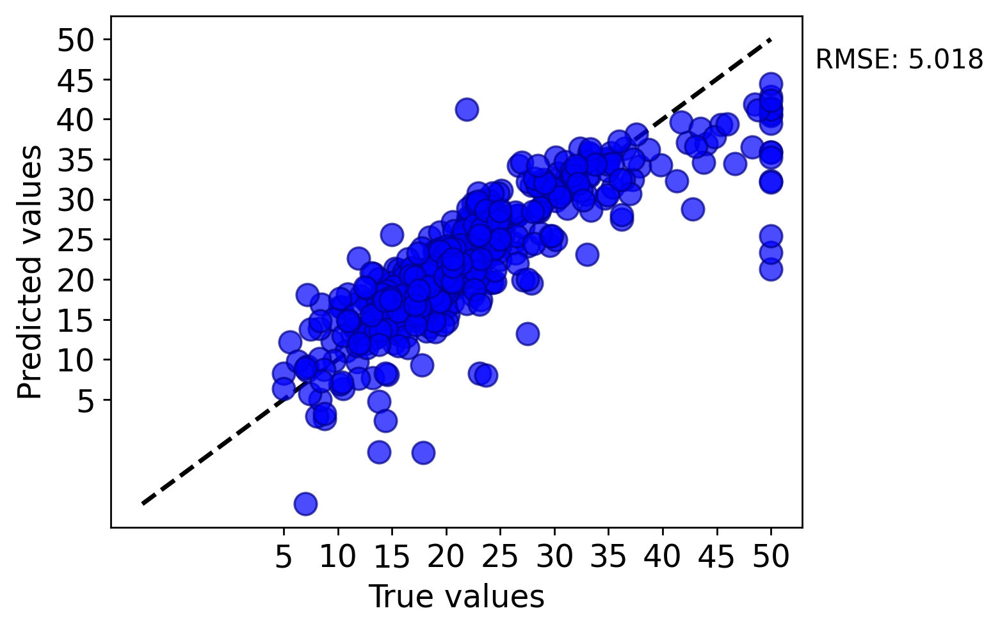

## Kernel ridge model test data parity plot:
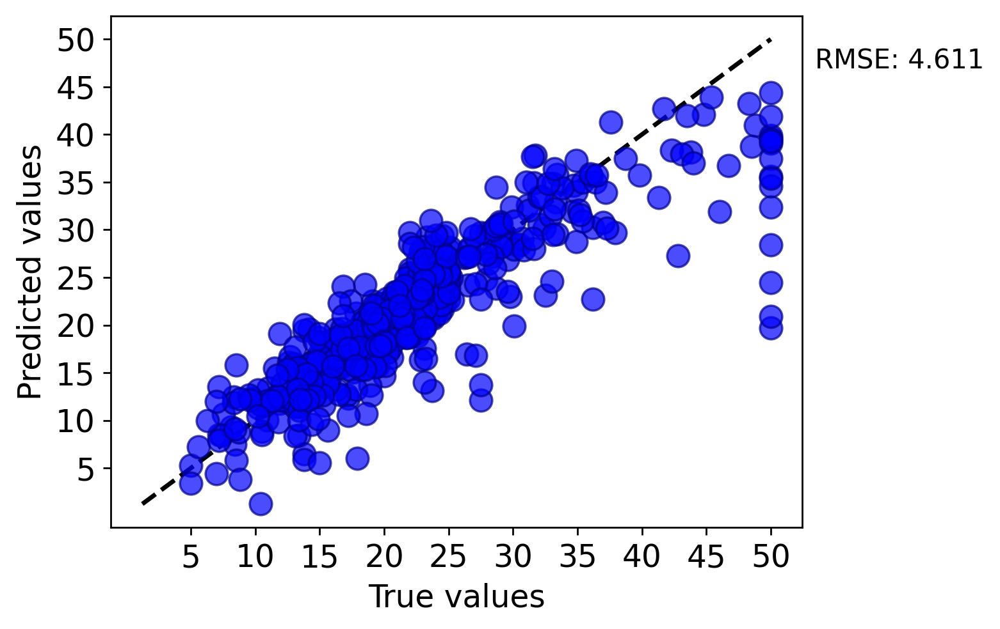

## Random forest model test data parity plot:
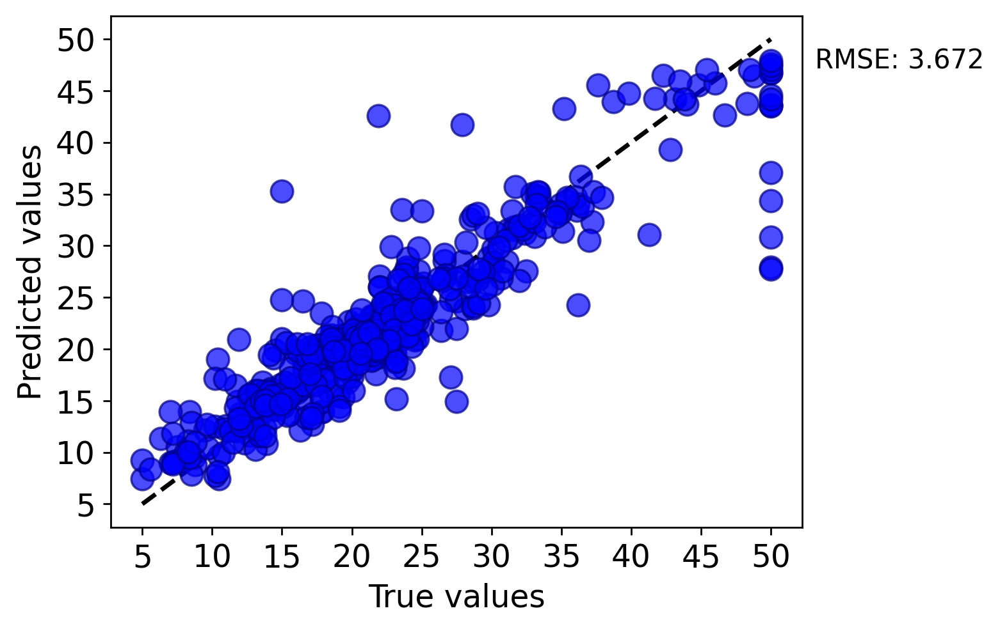

Another type of parity plot that MAST-ML creates is that showing the best and worst splits
from a particular test. Below is the best and worst splits on test data for our random forest
model:

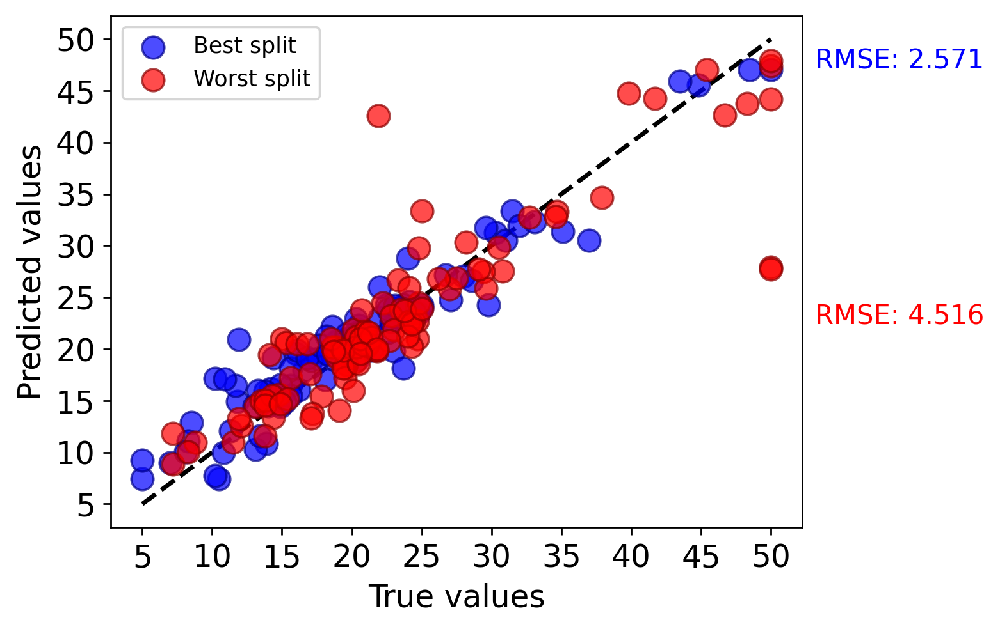

There are other types of analysis plots beyond these simple parity plots shown here. We will investigate
these pieces of analysis in more detail in future tutorials

Congratulations! You've completed your first MAST-ML run. This is just the first in a series of tutorial notebooks.
There are many other notebooks to explore that will guide you through different aspects of what MAST-ML can offer,
including the different types of output plots and data files, how to import your own data or download data from
commonly used online materials databases, fitting different types of models, more complex fits that involve tuning
hyperparameters, generating and selecting features, as well as in-depth model uncertainty quantification.

The next example in this notebook series is titled MASTML_Tutorial_2_DataImport.ipynb, and will guide you through the process of importing data from a local source and downloading and importing data from an online database

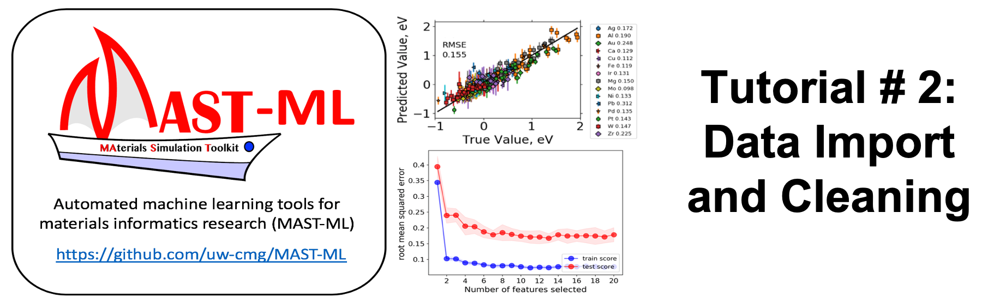

# Tutorial 2: Data Import and Data Cleaning with MAST-ML<a name="tutorial2"></a>

## In this tutorial, we will learn different ways to download and import data into a MAST-ML run: 

2.1. [Import model datasets from scikit-learn](#task21)

2.2. [Conduct different data cleaning methods](#task22)

2.3. [Import and prepare a real dataset that is stored locally](#task23)

2.4. [Download data from various materials databases](#task24)


## Task 2.1: Import model datasets from scikit-learn <a name="task21"></a>

In [ ]:
from mastml.mastml import Mastml
from mastml.datasets import SklearnDatasets, LocalDatasets, MatminerDatasets, FigshareDatasets, FoundryDatasets
from mastml.data_cleaning import DataCleaning
import numpy as np
from copy import copy
import mastml
import os 
data_path = os.path.join(mastml.__path__._path[0], 'data')

Here, we set the name of the savepath to save MAST-ML results to, and initialize our MAST-ML run

When the above command is run, a new folder with the name designated SAVEPATH is created. This is where all of the output for the current MAST-ML run will be saved to. Note that you can perform multiple runs with the same folder name, and the current datetime will be appended to the name so that no data is lost or overwritten.

In [ ]:
SAVEPATH = 'drive/MyDrive/MASTML_tutorial_2_DataImport'

mastml = Mastml(savepath=SAVEPATH)
savepath = mastml.get_savepath

Let's begin by first showing how to load some common model datasets that
come with the scikit-learn package. As in the first tutorial, we use the SklearnDatasets module 
to load in the data. There are a few regression datasets that come with scikit-learn, such as
the Boston housing data, the diabetes dataset, and the Friedman data set. For now,
let's once again load in the Boston housing dataset.

In [4]:
X, y = SklearnDatasets(as_frame=True).load_boston()

Let's quickly examine the X data so we know what we're dealing with:

In [5]:
X

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,1.0,296.0,15.3,396.90,4.98
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,2.0,242.0,17.8,396.90,9.14
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,2.0,242.0,17.8,392.83,4.03
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,3.0,222.0,18.7,394.63,2.94
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.1,2.4786,1.0,273.0,21.0,391.99,9.67
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.7,2.2875,1.0,273.0,21.0,396.90,9.08
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.0,2.1675,1.0,273.0,21.0,396.90,5.64
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.3,2.3889,1.0,273.0,21.0,393.45,6.48


## Task 2.2: Conduct different data cleaning method <a name="task22"></a>

We have 506 data points (houses) and 13 columns (features). From inspecting the dataset,
we can see there are no missing values in the dataset. However, many datasets in the real
world aren't this neat and tidy, and may contain values that are missing. To illustrate
how we can go about cleaning our data, let's make the first few rows of values in the AGE
column not-a-number (NaN), which is what they will be if you import a dataset with missing values:

In [6]:
X['AGE'][0:4] = np.nan
X

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
0,0.00632,18.0,2.31,0.0,0.538,6.575,NaN,4.0900,1.0,296.0,15.3,396.90,4.98
1,0.02731,0.0,7.07,0.0,0.469,6.421,NaN,4.9671,2.0,242.0,17.8,396.90,9.14
2,0.02729,0.0,7.07,0.0,0.469,7.185,NaN,4.9671,2.0,242.0,17.8,392.83,4.03
3,0.03237,0.0,2.18,0.0,0.458,6.998,NaN,6.0622,3.0,222.0,18.7,394.63,2.94
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.1,2.4786,1.0,273.0,21.0,391.99,9.67
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.7,2.2875,1.0,273.0,21.0,396.90,9.08
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.0,2.1675,1.0,273.0,21.0,396.90,5.64
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.3,2.3889,1.0,273.0,21.0,393.45,6.48


We can now see that the first four rows of the 'AGE' column are NaN instead
of their original values. Let's clean the data using a few different methods
in the DataCleaning class. First, let's copy the X data so we can more easily
see the changes we make to each dataset

In [7]:
X1row = X1col = X2 = X3 = X4 = copy(X)

There are few different ways we can clean the data: (1) we can simply 
remove the data points that have missing values, (2) we can perform
data imputation to replace the missing values with the mean (or median) value

Let's start with simply removing the problematic data points:

In [8]:
X1row, y1 = DataCleaning().remove(X=X1row, 
                                  y=y, 
                                  axis=0)
X1row

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33
5,0.02985,0.0,2.18,0.0,0.458,6.430,58.7,6.0622,3.0,222.0,18.7,394.12,5.21
6,0.08829,12.5,7.87,0.0,0.524,6.012,66.6,5.5605,5.0,311.0,15.2,395.60,12.43
7,0.14455,12.5,7.87,0.0,0.524,6.172,96.1,5.9505,5.0,311.0,15.2,396.90,19.15
8,0.21124,12.5,7.87,0.0,0.524,5.631,100.0,6.0821,5.0,311.0,15.2,386.63,29.93
...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.1,2.4786,1.0,273.0,21.0,391.99,9.67
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.7,2.2875,1.0,273.0,21.0,396.90,9.08
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.0,2.1675,1.0,273.0,21.0,396.90,5.64
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.3,2.3889,1.0,273.0,21.0,393.45,6.48


What we can see is that we now have 502 rows instead of the original 506. 
The four data points that had missing values in the AGE column have been removed.

Note that we could have instead removed the column (feature) containing
the missing values, as in our case all of the missing values were part of
a single feature:

In [9]:
X1col, y1 = DataCleaning().remove(X=X1col, 
                                  y=y, 
                                  axis=1)
X1col

,CRIM,ZN,INDUS,CHAS,NOX,RM,DIS,RAD,TAX,PTRATIO,B,LSTAT
0,0.00632,18.0,2.31,0.0,0.538,6.575,4.0900,1.0,296.0,15.3,396.90,4.98
1,0.02731,0.0,7.07,0.0,0.469,6.421,4.9671,2.0,242.0,17.8,396.90,9.14
2,0.02729,0.0,7.07,0.0,0.469,7.185,4.9671,2.0,242.0,17.8,392.83,4.03
3,0.03237,0.0,2.18,0.0,0.458,6.998,6.0622,3.0,222.0,18.7,394.63,2.94
4,0.06905,0.0,2.18,0.0,0.458,7.147,6.0622,3.0,222.0,18.7,396.90,5.33
...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,2.4786,1.0,273.0,21.0,391.99,9.67
502,0.04527,0.0,11.93,0.0,0.573,6.120,2.2875,1.0,273.0,21.0,396.90,9.08
503,0.06076,0.0,11.93,0.0,0.573,6.976,2.1675,1.0,273.0,21.0,396.90,5.64
504,0.10959,0.0,11.93,0.0,0.573,6.794,2.3889,1.0,273.0,21.0,393.45,6.48


What we can see is that we now have all 506 of our original data points,  
but we now just have 12 of the 13 features as the AGE feature has been removed.

There are smarter things we can do besides simply removing the problematic
data points. Here, let's use the imputation process to replace the missing
values with the mean value of the feature column

In [10]:
X2, y2 = DataCleaning().imputation(X=X2, 
                                   y=y, 
                                   strategy='mean')
X2

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
0,0.00632,18.0,2.31,0.0,0.538,6.575,68.621315,4.0900,1.0,296.0,15.3,396.90,4.98
1,0.02731,0.0,7.07,0.0,0.469,6.421,68.621315,4.9671,2.0,242.0,17.8,396.90,9.14
2,0.02729,0.0,7.07,0.0,0.469,7.185,68.621315,4.9671,2.0,242.0,17.8,392.83,4.03
3,0.03237,0.0,2.18,0.0,0.458,6.998,68.621315,6.0622,3.0,222.0,18.7,394.63,2.94
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.200000,6.0622,3.0,222.0,18.7,396.90,5.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.100000,2.4786,1.0,273.0,21.0,391.99,9.67
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.700000,2.2875,1.0,273.0,21.0,396.90,9.08
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.000000,2.1675,1.0,273.0,21.0,396.90,5.64
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.300000,2.3889,1.0,273.0,21.0,393.45,6.48


What we can see is that we now have all 506 of our original data points and 
all 13 of our feature columns, and the first four rows of the AGE feature
now contain the average value for that feature.

Finally, let's do imputation again but use the median instead of 
the mean value

In [11]:
X3, y3 = DataCleaning().imputation(X=X3, 
                                   y=y, 
                                   strategy='median')
X3

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT
0,0.00632,18.0,2.31,0.0,0.538,6.575,77.7,4.0900,1.0,296.0,15.3,396.90,4.98
1,0.02731,0.0,7.07,0.0,0.469,6.421,77.7,4.9671,2.0,242.0,17.8,396.90,9.14
2,0.02729,0.0,7.07,0.0,0.469,7.185,77.7,4.9671,2.0,242.0,17.8,392.83,4.03
3,0.03237,0.0,2.18,0.0,0.458,6.998,77.7,6.0622,3.0,222.0,18.7,394.63,2.94
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,3.0,222.0,18.7,396.90,5.33
...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0.0,0.573,6.593,69.1,2.4786,1.0,273.0,21.0,391.99,9.67
502,0.04527,0.0,11.93,0.0,0.573,6.120,76.7,2.2875,1.0,273.0,21.0,396.90,9.08
503,0.06076,0.0,11.93,0.0,0.573,6.976,91.0,2.1675,1.0,273.0,21.0,396.90,5.64
504,0.10959,0.0,11.93,0.0,0.573,6.794,89.3,2.3889,1.0,273.0,21.0,393.45,6.48


What we can see is that we now have all 506 of our original data points and 
all 13 of our feature columns, and the first four rows of the AGE feature
now contain the median value for that feature.

MAST-ML provides a convenient method for evaluating a data cleaning routine,
and saving the output to a dedicated folder in your MAST-ML output directory
Let's do imputation again on our final remaining dataset and examine what's
contained in the saved output:

In [12]:
X4, y4 = DataCleaning().evaluate(X=X4, 
                                 y=y, 
                                 method='imputation', 
                                 savepath=savepath, 
                                 strategy='mean')

Check your MAST-ML save directory: you'll see a new folder starting with the name "DataCleaning_..."
In here, there are numerous Excel data files and a histogram plot. Below is a brief overview
of what is contained in these files. One useful visualization is the histogram of the target data
you are trying to fit machine learning models to

**data_cleaned.xlsx:** the cleaned dataset

**data_columns_with_strings**: listed column names that contain string entries. Empty for our dataset

**data_original.xlsx**: the original dataset prior to cleaning

**data_outliers_all.xlsx**: a summary of the possible outlier points for each feature column

**data_outliers_summary.xlsx**: a summary showing, for each data point, the number of feature values which may be outliers

**histogram_target_values_statistics.xlsx**: key summary statistics of the distribution of y target data

**histogram_target_values.png**: histogram plot of the y target data with some basic statistics included

**histogram_target_values.xlsx**: the raw data used to make the histogram plot of the same name


### DataCleaning directory with files:

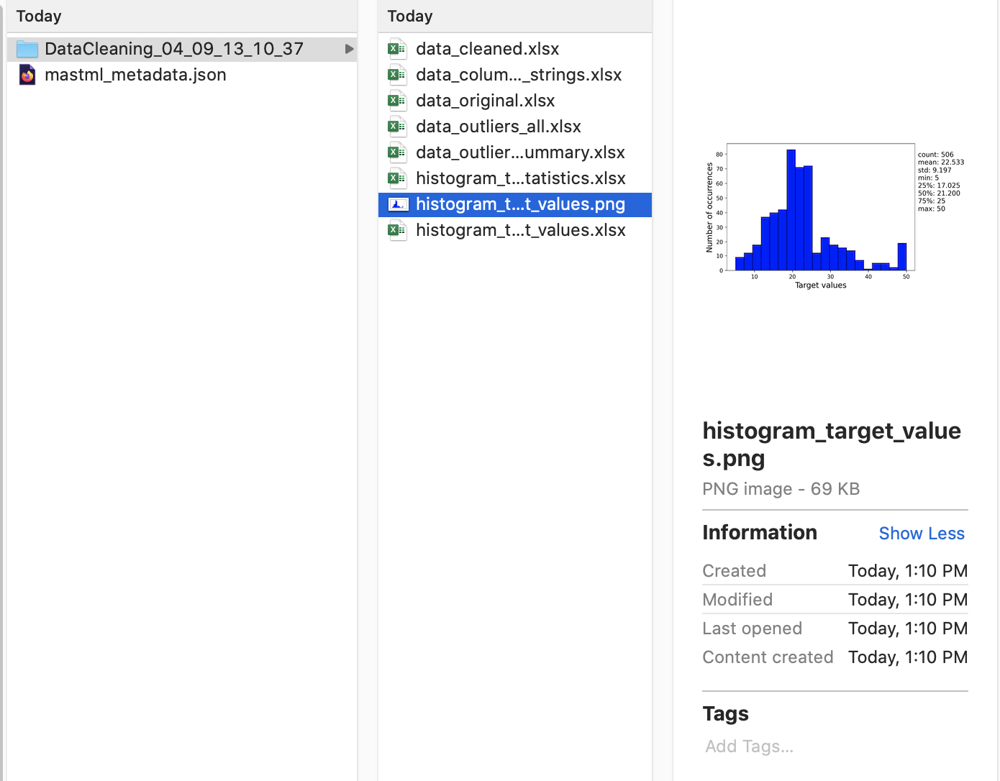

### Histogram of target values:
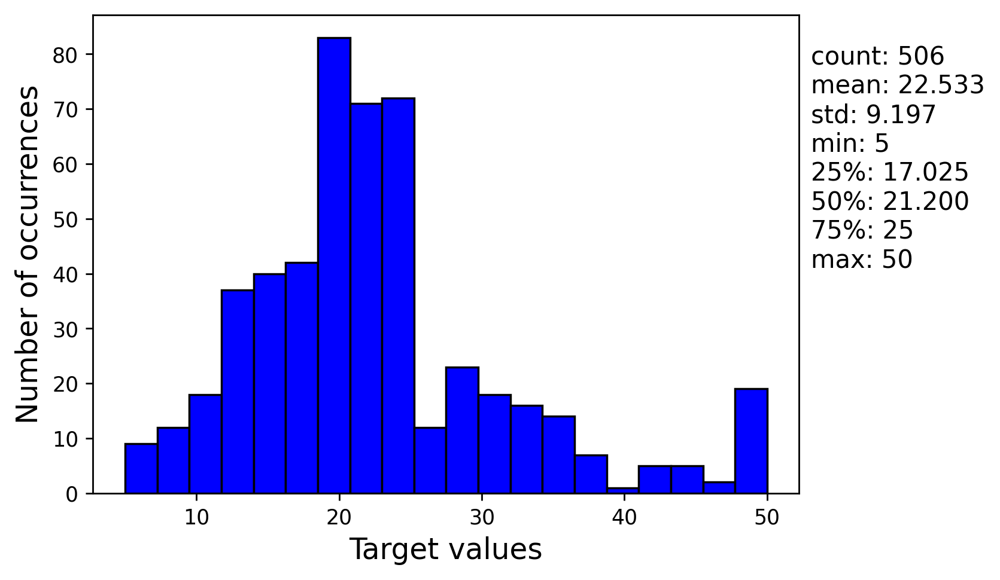

## Task 2.3: Import and prepare a real dataset that is stored locally  <a name="task23"></a>

Next, we want to move away from the model datasets contained in scikit-learn and learn how to import
a real materials science dataset. As part of MAST-ML, we have included a dataset in the mastml/data
folder. The data is contained there as diffusion_data_selectfeatures.xlsx. This dataset contains
calculated migration energies of solute alloys in metal host materials.

Here, we use the LocalDatasets module to load in the above mentioned diffusion dataset. 

We first need to denote the column name of the target (y-data)

In addition, there are columns in the data file not used as features or target. We need to
list them here in the parameter extra_columns

In [24]:
target = 'E_regression'

extra_columns = ['Material compositions 1', 'Material compositions 2', 'Hop activation barrier']

Here, we make an instance of our LocalDatasets class. It needs a few parameters:
   
**file_path**: where the data is stored

**target**: the column name of the y-data

**extra_columns**: list containing extra columns in the data file not used for fitting

**group_column**: column name denoting group labels (only used for LeaveOutGroup CV)
   
**testdata_columns**: column names denoting left-out data to evaluate using best
     model from CV tests. This is manual way to leave out data. Can also be done
     automatically using nested CV (we will do this in later tutorials)
   
**as_frame**: whether to return data as dataframe. Want this to be true.

We load the data with the load_data() method

In [25]:
d = LocalDatasets(file_path=data_path+'/diffusion_data_allfeatures.xlsx',
                  target=target, 
                  extra_columns=extra_columns, 
                  group_column='Material compositions 1',
                  testdata_columns=None,
                  as_frame=True)

data_dict = d.load_data()

Let's look at the contents of the loaded data_dict

We see there are 5 keys:
   
**X**: the X feature matrix (used to fit the ML model)
   
**y**: the y target data vector (true values)
   
**X_extra**: matrix of extra information not used in fitting (i.e. not part of X or y)
   
**groups**: vector of group labels (here, a list of host elements)

**X_testdata**: matrix or vector of left out data. Empty for our current example.

In [26]:
data_dict.keys()

dict_keys(['X', 'y', 'groups', 'X_extra', 'X_testdata'])

Let's assign each data object to its respective name

In [27]:
X = data_dict['X']
y = data_dict['y']
X_extra = data_dict['X_extra']
groups = data_dict['groups']
X_testdata = data_dict['X_testdata']

Let's have a look at the X feature matrix. It contains 287 elemental features.
There are a total of 408 diffusion activation barriers used for fitting

In [28]:
X

,valence_composition_average,phi_composition_average,NdValence_composition_average,MiracleRadius_composition_average,GSestFCClatcnt_composition_average,SecondIonizationEnergy_composition_average,IonizationEnergy_composition_average,n_ws^third_composition_average,ThermalConductivity_composition_average,CovalentRadius_composition_average,Column_composition_average,NsValence_composition_average,NUnfilled_composition_average,CovalentRadii_composition_average,Density_composition_average,BCCenergy_pa_composition_average,BCCvolume_padiff_composition_average,BCCvolume_pa_composition_average,MeltingT_composition_average,SpaceGroupNumber_composition_average,NValance_composition_average,ElectricalConductivity_composition_average,FirstIonizationEnergy_composition_average,GSvolume_pa_composition_average,Row_composition_average,Polarizability_composition_average,AtomicNumber_composition_average,ElectronAffinity_composition_average,BCCfermi_composition_average,GSestBCClatcnt_composition_average,HHIr_composition_average,HHIp_composition_average,GSenergy_pa_composition_average,ThirdIonizationEnergy_composition_average,BulkModulus_composition_average,BoilingT_composition_average,ICSDVolume_composition_average,HeatVaporization_composition_average,IonicRadii_composition_average,NdUnfilled_composition_average,...,Site2_NdValence,Site2_MiracleRadius,Site2_GSestFCClatcnt,Site2_IonizationEnergy,Site2_ThermalConductivity,Site2_CovalentRadius,Site2_Column,Site2_NUnfilled,Site2_CovalentRadii,Site2_Density,Site2_BCCenergy_pa,Site2_BCCvolume_padiff,Site2_BCCvolume_pa,Site2_MeltingT,Site2_SpaceGroupNumber,Site2_NValance,Site2_ElectricalConductivity,Site2_FirstIonizationEnergy,Site2_GSvolume_pa,Site2_Row,Site2_Polarizability,Site2_AtomicNumber,Site2_BCCfermi,Site2_GSestBCClatcnt,Site2_GSenergy_pa,Site2_BoilingT,Site2_ICSDVolume,Site2_HeatVaporization,Site2_IonicRadii,Site2_NdUnfilled,Site2_MendeleevNumber,Site2_ElasticModulus,Site2_Electronegativity,Site2_AtomicWeight,Site2_HeatFusion,Site2_SpecificHeatCapacity,Site2_AtomicRadii,Site2_ThermalExpansionCoefficient,Site2_BCCefflatcnt,Site2_AtomicVolume
0,2.0,4.350,10.0,144.0,4.027313,21.4900,731.00,1.360,429.00,145.0,11.0,1.0,1.0,1.340,10490.0,-2.719979,-0.1300,16.200,1234.930,225.0,11.0,62.90,7.576230,16.3300,5.0,6.990,47.0,125.70,4.052760,3.196481,1400,1200,-2.765394,34.8300,100.0,2435.0,17.00,250.630,1.150,0.0,...,10,144,4.027313,731.0,429.0,145,11,1,1.34,10490,-2.719979,-0.130,16.20,1234.93,225,11,62.9,7.57623,16.330,5,6.99,47,4.052760,3.196481,-2.765394,2435.0,17.0,250.63,1.15,0,65,80.0,1.93,107.868200,11.30,0.235,1.444,18.9,6.375951,17.075648
1,2.5,4.725,8.5,134.5,3.737485,19.2750,744.50,1.555,264.50,135.5,10.0,1.5,2.0,1.250,9695.0,-4.850033,0.0325,13.320,1501.465,209.5,10.0,40.40,7.728620,13.2875,4.5,7.245,37.0,97.85,5.096587,2.966444,2050,2150,-4.922891,34.1650,140.0,2817.5,14.05,311.965,0.900,1.5,...,7,125,3.447656,758.0,100.0,126,9,3,1.16,8900,-6.980087,0.195,10.44,1768.00,194,9,17.9,7.88101,10.245,4,7.50,27,6.140415,2.736407,-7.080389,3200.0,11.1,373.30,0.65,3,58,208.0,1.88,58.933195,16.20,0.421,1.253,13.0,5.507318,10.995861
2,4.0,4.500,7.5,137.0,3.788936,18.9950,691.90,1.545,261.35,142.0,8.5,1.0,3.5,1.260,8815.0,-6.112393,-0.0750,13.685,1707.465,227.0,8.5,35.40,7.171370,13.7600,4.5,9.295,35.5,94.85,6.014901,3.007280,2750,2150,-6.135555,32.8950,130.0,2689.5,14.50,295.065,0.885,2.5,...,5,130,3.550559,652.8,93.7,139,6,6,1.18,7140,-9.504808,-0.020,11.17,2180.00,229,6,7.9,6.76651,11.190,4,11.60,24,7.977043,2.818080,-9.505717,2944.0,12.0,339.50,0.62,5,49,259.0,1.66,51.996100,21.00,0.449,1.249,4.9,5.632801,12.092937
3,2.0,4.400,10.0,135.0,3.782567,20.8910,738.20,1.415,415.00,138.5,11.0,1.0,1.0,1.255,9705.0,-3.181433,-0.0600,13.640,1296.350,225.0,11.0,61.80,7.651305,13.7000,4.5,6.570,38.0,122.00,4.215750,3.002225,1450,1400,-3.223024,35.8300,120.0,2817.5,14.40,275.565,0.940,0.0,...,10,126,3.537821,745.4,401.0,132,11,1,1.17,8920,-3.642887,0.010,11.08,1357.77,225,11,60.7,7.72638,11.070,4,6.15,29,4.378740,2.80

Let's look at the groups list. The groups denote the element identity of the host metal

In [29]:
groups

0      Ag
1      Ag
2      Ag
3      Ag
4      Ag
       ..
403    Zr
404    Zr
405    Zr
406    Zr
407    Zr
Name: Material compositions 1, Length: 408, dtype: object

Let's examine the extra data not used in fitting. Note that the y-data we are 
fitting to are equal to the E_regression values listed here, minus the E_regression
value of the pure material. Material compositions 1 are the host elements, which
are the same values used in the groups list. Material compositions 2 are the solute
elements (i.e. the diffusing impurity in the host material)

In [30]:
X_extra

,Material compositions 1,Material compositions 2,Hop activation barrier
0,Ag,Ag,-0.365590
1,Ag,Co,-0.675263
2,Ag,Cr,-0.047690
3,Ag,Cu,-0.428459
4,Ag,Fe,0.081529
...,...,...,...
403,Zr,Nb,-0.478007
404,Zr,Ta,-0.054726
405,Zr,Ti,-0.022476
406,Zr,Hf,-0.104201


Finally, we can look at our manually left-out data set. For this tutorial we
have left this blank, but we will make use of it in a future tutorial

In [31]:
X_testdata

## Task 2.4: Download and import data from various materials databases  <a name="task24"></a>

Next, let's download some datasets from remote materials databases, then import
them for use in MAST-ML

Here, we will download a materials dataset of steel alloy yield strengths from the 
matminer datasets repository:

In [32]:
df = MatminerDatasets().download_data(name='steel_strength')

Fetching steel_strength.json.gz from https://ndownloader.figshare.com/files/13354691 to /usr/local/lib/python3.7/dist-packages/matminer/datasets/steel_strength.json.gz


The output of downloading this data is a pandas dataframe. If we know which columns
correspond to X, y, X_extra, and so on, we can designate those fields here through
pandas commands. Alternatively, we can import the just-saved steel_strength.xlsx file
using the LocalDatasets class just like we did in the previous task:

In [33]:
target = 'yield strength'
extra_columns = ['formula', 'tensile strength', 'elongation']

d = LocalDatasets(file_path='steel_strength.xlsx', 
                  target=target, 
                  extra_columns=extra_columns, 
                  group_column=None,
                  testdata_columns=None,
                  as_frame=True)

# Load the data with the load_data() method
data_dict = d.load_data()

# Designate the X, y and X_extra data 
X = data_dict['X']
y = data_dict['y']
X_extra = data_dict['X_extra']

Let's have a look at the X feature matrix for this data. 
The X features are the atom fractions of different elements
in each steel alloy

In [34]:
X

,c,mn,si,cr,ni,mo,v,n,nb,co,w,al,ti
0,0.02,0.05,0.05,0.01,19.70,2.95,0.01,0.00,0.01,15.00,0.00,0.15,1.55
1,0.18,0.01,0.01,13.44,0.01,3.01,0.46,0.04,0.01,19.46,2.35,0.04,0.00
2,0.00,0.01,0.01,8.67,13.45,0.82,0.01,0.00,0.01,13.90,0.00,0.39,0.57
3,0.01,0.05,0.05,0.01,17.70,3.95,0.01,0.00,0.01,15.00,0.00,0.13,1.47
4,0.01,0.05,0.05,0.01,19.40,1.45,0.01,0.00,0.01,14.90,0.00,0.13,1.55
...,...,...,...,...,...,...,...,...,...,...,...,...,...
307,0.38,0.18,0.01,7.27,0.01,3.77,0.96,0.00,0.01,4.90,0.00,0.03,0.00
308,0.00,0.06,0.05,5.15,10.20,3.20,0.01,0.00,0.01,0.01,0.00,0.03,0.09
309,0.37,0.17,0.01,5.20,0.01,5.84,1.05,0.00,0.91,4.88,0.00,0.03,0.00
310,0.41,0.19,0.01,6.99,0.01,5.84,0.92,0.00,0.01,0.02,0.00,0.03,0.00


Let's have a look at the y target data. They data are yield strengths (in MPa) for each alloy

In [35]:
y

0      2411.5
1      1123.1
2      1736.3
3      2487.3
4      2249.6
        ...  
307    1722.5
308    1019.0
309    1860.3
310    1812.1
311    1139.7
Name: yield strength, Length: 312, dtype: float64

There are many other datasets besides this steel strength dataset
available on the matminer repository. Information on these other
datasets, and the names used to query them, can be output using:

In [36]:
MatminerDatasets().get_available_datasets()

boltztrap_mp: Effective mass and thermoelectric properties of 8924 compounds in The  Materials Project database that are calculated by the BoltzTraP software package run on the GGA-PBE or GGA+U density functional theory calculation results. The properties are reported at the temperature of 300 Kelvin and the carrier concentration of 1e18 1/cm3.

brgoch_superhard_training: 2574 materials used for training regressors that predict shear and bulk modulus.

castelli_perovskites: 18,928 perovskites generated with ABX combinatorics, calculating gllbsc band gap and pbe structure, and also reporting absolute band edge positions and heat of formation.

citrine_thermal_conductivity: Thermal conductivity of 872 compounds measured experimentally and retrieved from Citrine database from various references. The reported values are measured at various temperatures of which 295 are at room temperature.

dielectric_constant: 1,056 structures with dielectric properties, calculated with DFPT-PBE.

double_

As one last example, let's look at how to download datasets that are 
hosted on Figshare. To use the Figshare data import, we need to 
first install the python package to query Figshare datasets:

In [37]:
!git clone https://github.com/cognoma/figshare.git
import sys
sys.path.append('figshare')

Cloning into 'figshare'...
remote: Enumerating objects: 18, done.
remote: Counting objects: 100% (18/18), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 53 (delta 6), reused 9 (delta 1), pack-reused 35
Unpacking objects: 100% (53/53), done.


Note that you may need to restart your runtime (if on Colab) so that Colab can find the Figshare module

Now we can download a dataset from Figshare. The diffusion dataset
we examined earlier is hosted on Figshare, with article ID number 7418492. 
Let's download it to our working environment:

In [1]:
from mastml.datasets import FigshareDatasets
FigshareDatasets().download_data(article_id='7418492')

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


We can now see the new folder "figshare_7418492" has been downloaded,
and within it is the data file "All_Model_Data.xlsx". This is the same
file we imported earlier from mastml/data when demonstrating the use
of the LocalDatasets class. As with this file or other datasets downloaded
from Figshare or other remote datasets, after downloading the data files
you can import them into MAST-ML using the LocalDatasets class as we 
learned in this tutorial.

You've now completed your second MAST-ML tutorial notebook! Now that you're more familiar with working with datasets
within MAST-ML, the next thing for us to do is look at feature engineering in more detail. 

The next example in this notebook series is titled MASTML_Tutorial_3_FeatureEngineering.ipynb, and will guide you through the process
of generating, preprocessing, and selecting features for a particular model and data split test.

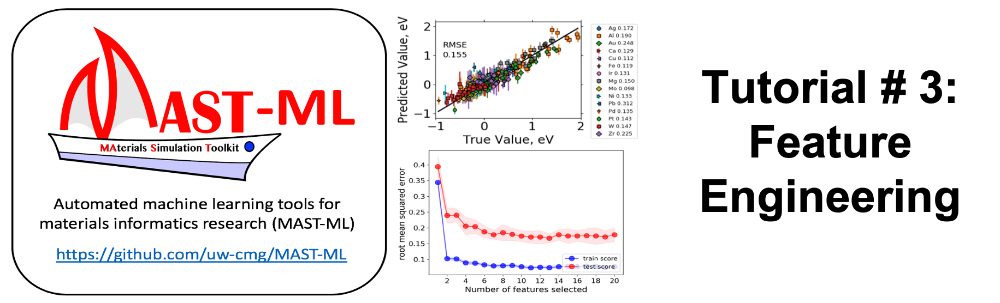

# Tutorial 3: Feature Engineering with MAST-ML! <a name="tutorial3"></a>

## In this tutorial, we will learn different ways to generate, preprocess, and select features:


3.1. [Generate features based on material composition](#task31)

3.2. [Generate one-hot encoded features based on group labels](#task32)

3.3. [Preprocess features to be normalized](#task33)

3.4. [Select features using an ensemble model-based approach](#task34)

3.5. [Generate learning curves using a basic feature selection approach](#task35)

3.6. [Select features using forward selection](#task36)


Here we import the MAST-ML modules used in this tutorial

In [3]:
from mastml.mastml import Mastml
from mastml.datasets import LocalDatasets
from mastml.models import SklearnModel
from mastml.preprocessing import SklearnPreprocessor
from mastml.feature_selectors import SklearnFeatureSelector, EnsembleModelFeatureSelector
from mastml.feature_generators import ElementalFeatureGenerator, OneHotGroupGenerator
from mastml.learning_curve import LearningCurve
import numpy as np
from copy import copy
import mastml
import os
data_path = os.path.join(mastml.__path__._path[0], 'data')

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


Figshare is an optional dependency. To import data from figshare, manually install figshare via git clone of git clone https://github.com/cognoma/figshare.git
forestci is an optional dependency. To install latest forestci compatabilty with scikit-learn>=0.24, run pip install git+git://github.com/scikit-learn-contrib/forest-confidence-interval.git


Here, we set the name of the savepath to save MAST-ML results to, and initialize
our MAST-ML run

When the above command is run, a new folder with the name designated SAVEPATH is created.
This is where all of the output for the current MAST-ML run will be saved to.
Note that you can perform multiple runs with the same folder name, and the current datetime
will be appended to the name so that no data is lost or overwritten.

In [7]:
SAVEPATH = 'drive/MyDrive/MASTML_tutorial_3_FeatureEngineering'

mastml = Mastml(savepath=SAVEPATH)
savepath = mastml.get_savepath

drive/MyDrive/MASTML_tutorial_3_FeatureEngineering not empty. Renaming...


## Task 3.1: Generate features based on material composition <a name="task31"></a>

Let's import the diffusion data used in the previous tutorial again
using the LocalDatasets class. This time, we are using a version
where there are no X features, and we will proceed to generate new features

In [5]:
target = 'E_regression'
extra_columns = ['Material compositions 1', 'Material compositions 2', 'Material compositions joined']

d = LocalDatasets(file_path=data_path+'/diffusion_data_nofeatures.xlsx', 
                  target=target, 
                  extra_columns=extra_columns, 
                  group_column='Material compositions 1',
                  testdata_columns=None,
                  as_frame=True)

# Load the data with the load_data() method
data_dict = d.load_data()

# Designate the X, y and X_extra data 
X = data_dict['X']
y = data_dict['y']
X_extra = data_dict['X_extra']
groups = data_dict['groups']


If we look at the X feature data, we see that it is empty. We need to make some
features to described our data!

In [7]:
X

""
0
1
2
3
4
...
403
404
405
406


Since this dataset contains materials composition strings, we can create
features of the compositinos using elemental properties of the elements
in each composition. We can do that using the ElementalFeatureGenerator
class. The ElementalFeatureGenerator takes the following arguments:

composition_df : a dataframe with the composition strings to featurize
feature_types : list denoting which types of elemental feature operations to make
remove_constant_columns : bool denoting whether columns with same value for each point are removed

The evaluate() method conducts the feature generation and saves the output to a designated
folder under the provided savepath. In this folder, the generated data is saved as the file
generated_features.xlsx

In [8]:
X, y = ElementalFeatureGenerator(composition_df=X_extra['Material compositions joined'], 
                                 feature_types=['composition_avg', 'arithmetic_avg', 'max', 'min', 'difference'], 
                                 remove_constant_columns=True).evaluate(X=X, y=y, savepath=savepath, make_new_dir=True)

Dropping 5/440 generated columns due to missing values


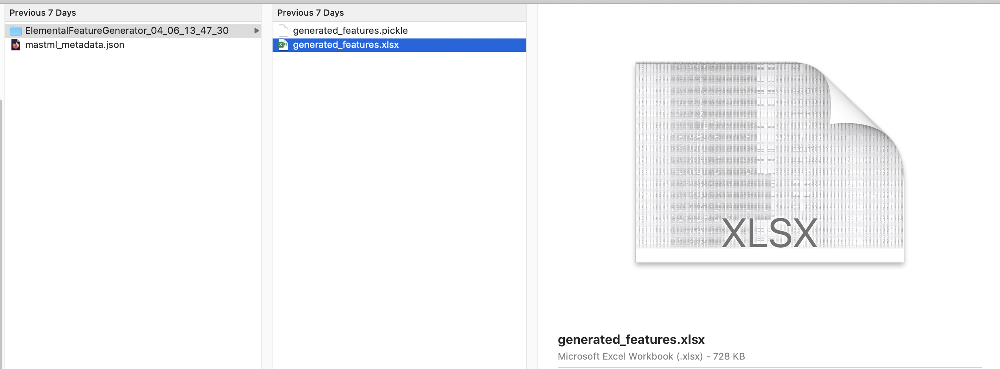

Now let's examine what the X data look like:

We can see that we now have 404 generated features based on properties of the elements

In [9]:
X

,AtomicNumber_arithmetic_average,AtomicNumber_composition_average,AtomicNumber_difference,AtomicNumber_max_value,AtomicNumber_min_value,AtomicRadii_arithmetic_average,AtomicRadii_composition_average,AtomicRadii_difference,AtomicRadii_max_value,AtomicRadii_min_value,AtomicVolume_arithmetic_average,AtomicVolume_composition_average,AtomicVolume_difference,AtomicVolume_max_value,AtomicVolume_min_value,AtomicWeight_arithmetic_average,AtomicWeight_composition_average,AtomicWeight_difference,AtomicWeight_max_value,AtomicWeight_min_value,BCCefflatcnt_arithmetic_average,BCCefflatcnt_composition_average,BCCefflatcnt_difference,BCCefflatcnt_max_value,BCCefflatcnt_min_value,BCCenergy_pa_arithmetic_average,BCCenergy_pa_composition_average,BCCenergy_pa_max_value,BCCenergy_pa_min_value,BCCfermi_arithmetic_average,BCCfermi_composition_average,BCCfermi_difference,BCCfermi_max_value,BCCfermi_min_value,BCCmagmom_arithmetic_average,BCCmagmom_composition_average,BCCmagmom_difference,BCCmagmom_max_value,BCCmagmom_min_value,BCCvolume_pa_arithmetic_average,...,SpaceGroupNumber_arithmetic_average,SpaceGroupNumber_composition_average,SpaceGroupNumber_difference,SpaceGroupNumber_max_value,SpaceGroupNumber_min_value,SpecificHeatCapacity_arithmetic_average,SpecificHeatCapacity_composition_average,SpecificHeatCapacity_difference,SpecificHeatCapacity_max_value,SpecificHeatCapacity_min_value,ThermalConductivity_arithmetic_average,ThermalConductivity_composition_average,ThermalConductivity_difference,ThermalConductivity_max_value,ThermalConductivity_min_value,ThermalExpansionCoefficient_arithmetic_average,ThermalExpansionCoefficient_composition_average,ThermalExpansionCoefficient_difference,ThermalExpansionCoefficient_max_value,ThermalExpansionCoefficient_min_value,ThirdIonizationEnergy_arithmetic_average,ThirdIonizationEnergy_composition_average,ThirdIonizationEnergy_difference,ThirdIonizationEnergy_max_value,ThirdIonizationEnergy_min_value,n_ws^third_arithmetic_average,n_ws^third_composition_average,n_ws^third_difference,n_ws^third_max_value,n_ws^third_min_value,phi_arithmetic_average,phi_composition_average,phi_difference,phi_max_value,phi_min_value,valence_arithmetic_average,valence_composition_average,valence_difference,valence_max_value,valence_min_value
0,47.0,47.0,0.0,47.0,47.0,1.4440,1.4440,0.000,1.444,1.444,17.075648,17.075648,0.000000,17.075648,17.075648,107.868200,107.868200,0.000000,107.86820,107.868200,6.375951,6.375951,0.000000,6.375951,6.375951,-2.719979,-2.719979,-2.719979,-2.719979,4.052760,4.052760,0.000000,4.052760,4.052760,0.000000,0.000000,0.0,0.000000,0.000000,16.200,...,225.0,225.0,0.0,225.0,225.0,0.2350,0.2350,0.000,0.235,0.235,429.00,429.00,0.0,429.0,429.0,18.90,18.90,0.0,18.9,18.9,34.8300,34.8300,0.000,34.830,34.830,1.360,1.360,0.00,1.36,1.36,4.350,4.350,0.00,4.35,4.35,2.0,2.0,0.0,2.0,2.0
1,37.0,37.0,20.0,47.0,27.0,1.3485,1.3485,0.191,1.444,1.253,14.035754,14.035754,6.079787,17.075648,10.995861,83.400698,83.400698,48.935005,107.86820,58.933195,5.941635,5.941635,0.868633,6.375951,5.507318,-4.850033,-4.850033,-2.719979,-2.719979,5.096587,5.096587,2.087655,6.140415,4.052760,0.842019,0.842019,0.0,1.684037,1.684037,13.320,...,209.5,209.5,31.0,225.0,194.0,0.3280,0.3280,0.186,0.421,0.235,264.50,264.50,329.0,429.0,100.0,15.95,15.95,5.9,18.9,13.0,34.1650,34.1650,1.330,34.830,33.500,1.555,1.555,0.39,1.75,1.36,4.725,4.725,0.75,5.10,4.35,2.5,2.5,1.0,3.0,2.0
2,35.5,35.5,23.0,47.0,24.0,1.3465,1.3465,0.195,1.444,1.249,14.584293,14.584293,4.982710,17.075648,12.092937,79.932150,79.932150,55.872100,107.86820,51.996100,6.004376,6.004376,0.743151,6.375951,5.632801,-6.112393,-6.112393,-2.719979,-2.719979,6.014901,6.014901,3.924283,7.977043,4.052760,0.000000,0.000000,0.0,0.000000,0.000000,13.685,...,227.0,227.0,4.0,229.0,225.0,0.3420,0.3420,0.214,0.449,0.235,261.35,261.35,335.3,429.0,93.7,11.90,11.90,14.0,18.9,4.9,32.8950,32.8950,3.870,34.830,30.960,1.545,1.545,0.37,1.73,1.36,4.500,4.500,0.30,4.65,4.35,4.0,4.0,4.0,6.0,2.0
3,38.0,38.0,18.0,47.0,29.0,1.361

## Task 3.2: Generate one-hot encoded features based on group labels <a name="task32"></a>

We have generated a large feature set based on properties of the elements,
but we can also add more features based on one-hot encoding of the 
different host groups each data point corresponds to. The host elements
are contained in the Material Compositions 1 column in X_extra

We can also view the unique groups only:

In [10]:
np.unique(X_extra['Material compositions 1'])

array(['Ag', 'Al', 'Au', 'Ca', 'Cu', 'Fe', 'Ir', 'Mg', 'Mo', 'Ni', 'Pb',
       'Pd', 'Pt', 'W', 'Zr'], dtype=object)

There are 15 unique groups. We can create one-hot encoded vectors of 
each group with the OneHotGroupGenerator class. Like with the previous
feature generation scheme, running the evaluate() method for this class
will create an output folder with the generated data saved as the file
generated_features.xlsx

In [9]:
X, y = OneHotGroupGenerator(groups=X_extra['Material compositions 1']).evaluate(X=X, y=y, savepath=savepath, make_new_dir=True)

Let's look at our generated features once more:

We can now see that we have 419 features, meaning we added 15 new one-hot 
encoded features to our previous set of 404 elemental features. The new
one-hot encoded features are appended to the right-hand end of the 
dataframe.

In [12]:
X

,AtomicNumber_arithmetic_average,AtomicNumber_composition_average,AtomicNumber_difference,AtomicNumber_max_value,AtomicNumber_min_value,AtomicRadii_arithmetic_average,AtomicRadii_composition_average,AtomicRadii_difference,AtomicRadii_max_value,AtomicRadii_min_value,AtomicVolume_arithmetic_average,AtomicVolume_composition_average,AtomicVolume_difference,AtomicVolume_max_value,AtomicVolume_min_value,AtomicWeight_arithmetic_average,AtomicWeight_composition_average,AtomicWeight_difference,AtomicWeight_max_value,AtomicWeight_min_value,BCCefflatcnt_arithmetic_average,BCCefflatcnt_composition_average,BCCefflatcnt_difference,BCCefflatcnt_max_value,BCCefflatcnt_min_value,BCCenergy_pa_arithmetic_average,BCCenergy_pa_composition_average,BCCenergy_pa_max_value,BCCenergy_pa_min_value,BCCfermi_arithmetic_average,BCCfermi_composition_average,BCCfermi_difference,BCCfermi_max_value,BCCfermi_min_value,BCCmagmom_arithmetic_average,BCCmagmom_composition_average,BCCmagmom_difference,BCCmagmom_max_value,BCCmagmom_min_value,BCCvolume_pa_arithmetic_average,...,ThermalExpansionCoefficient_arithmetic_average,ThermalExpansionCoefficient_composition_average,ThermalExpansionCoefficient_difference,ThermalExpansionCoefficient_max_value,ThermalExpansionCoefficient_min_value,ThirdIonizationEnergy_arithmetic_average,ThirdIonizationEnergy_composition_average,ThirdIonizationEnergy_difference,ThirdIonizationEnergy_max_value,ThirdIonizationEnergy_min_value,n_ws^third_arithmetic_average,n_ws^third_composition_average,n_ws^third_difference,n_ws^third_max_value,n_ws^third_min_value,phi_arithmetic_average,phi_composition_average,phi_difference,phi_max_value,phi_min_value,valence_arithmetic_average,valence_composition_average,valence_difference,valence_max_value,valence_min_value,Material compositions 1_0,Material compositions 1_1,Material compositions 1_2,Material compositions 1_3,Material compositions 1_4,Material compositions 1_5,Material compositions 1_6,Material compositions 1_7,Material compositions 1_8,Material compositions 1_9,Material compositions 1_10,Material compositions 1_11,Material compositions 1_12,Material compositions 1_13,Material compositions 1_14
0,47.0,47.0,0.0,47.0,47.0,1.4440,1.4440,0.000,1.444,1.444,17.075648,17.075648,0.000000,17.075648,17.075648,107.868200,107.868200,0.000000,107.86820,107.868200,6.375951,6.375951,0.000000,6.375951,6.375951,-2.719979,-2.719979,-2.719979,-2.719979,4.052760,4.052760,0.000000,4.052760,4.052760,0.000000,0.000000,0.0,0.000000,0.000000,16.200,...,18.90,18.90,0.0,18.9,18.9,34.8300,34.8300,0.000,34.830,34.830,1.360,1.360,0.00,1.36,1.36,4.350,4.350,0.00,4.35,4.35,2.0,2.0,0.0,2.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,37.0,37.0,20.0,47.0,27.0,1.3485,1.3485,0.191,1.444,1.253,14.035754,14.035754,6.079787,17.075648,10.995861,83.400698,83.400698,48.935005,107.86820,58.933195,5.941635,5.941635,0.868633,6.375951,5.507318,-4.850033,-4.850033,-2.719979,-2.719979,5.096587,5.096587,2.087655,6.140415,4.052760,0.842019,0.842019,0.0,1.684037,1.684037,13.320,...,15.95,15.95,5.9,18.9,13.0,34.1650,34.1650,1.330,34.830,33.500,1.555,1.555,0.39,1.75,1.36,4.725,4.725,0.75,5.10,4.35,2.5,2.5,1.0,3.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,35.5,35.5,23.0,47.0,24.0,1.3465,1.3465,0.195,1.444,1.249,14.584293,14.584293,4.982710,17.075648,12.092937,79.932150,79.932150,55.872100,107.86820,51.996100,6.004376,6.004376,0.743151,6.375951,5.632801,-6.112393,-6.112393,-2.719979,-2.719979,6.014901,6.014901,3.924283,7.977043,4.052760,0.000000,0.000000,0.0,0.000000,0.000000,13.685,...,11.90,11.90,14.0,18.9,4.9,32.8950,32.8950,3.870,34.830,30.960,1.545,1.545,0.37,1.73,1.36,4.500,4.500,0.30,4.65,4.35,4.0,4.0,4.0,6.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,38.0,38.0,18.0,47.0,29.0,1.3610,1.3610,0.166,1.444,1.278,14.452795,14.452795,5.245706,17.075648,11.829942,85.707100,85.707100,44.322200,107.86820,63.546000,5.996791,5.996791,0.758320,6.375951,5.617632,-3.181433,-3.181433,-2.71997

## Task 3.3: Preprocess features to be normalized <a name="task33"></a>

We now have a complete set of reasonable features to use going forward.
However, our features span different ranges based on their physical meaning, 
which can distort how a machine learning model may behave. It is common
to normalize or standardize the data in some way prior to fitting. Here,
we invoke a common approach which is to normalize the data so that
each feature has mean of 0 and standard deviation of 1. We can do this
with the StandardScaler method in the SklearnPreprocessor class

In [10]:
preprocessor = SklearnPreprocessor(preprocessor='StandardScaler', as_frame=True)

If we want to go ahead an normalize our full dataset in one go, we can
do that now. Alternatively, we will see in the next tutorial that you can 
pass the preprocessor object into a MAST-ML data splitter workflow, where
the preprocessor will be used in each train/test split to standardize the
data.

In [11]:
X = preprocessor.evaluate(X=X, y=y, savepath=savepath, make_new_dir=True)
Xcopy = copy(X) # Reserve this copy of the full dataset for later

The resulting normalized dataset is saved to the file data_preprocessed.xlsx,
and the fitted preprocessor class is saved as a .pkl file. This will be useful
for preprocessing new data used for future predictions or if the model is 
to be uploaded to the model hosting service DLHub

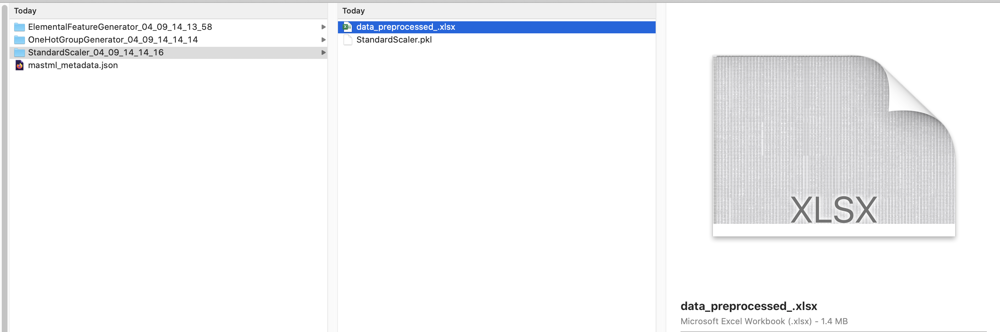

Let's look at our newly preprocessed data:

In [15]:
X

,AtomicNumber_arithmetic_average,AtomicNumber_composition_average,AtomicNumber_difference,AtomicNumber_max_value,AtomicNumber_min_value,AtomicRadii_arithmetic_average,AtomicRadii_composition_average,AtomicRadii_difference,AtomicRadii_max_value,AtomicRadii_min_value,AtomicVolume_arithmetic_average,AtomicVolume_composition_average,AtomicVolume_difference,AtomicVolume_max_value,AtomicVolume_min_value,AtomicWeight_arithmetic_average,AtomicWeight_composition_average,AtomicWeight_difference,AtomicWeight_max_value,AtomicWeight_min_value,BCCefflatcnt_arithmetic_average,BCCefflatcnt_composition_average,BCCefflatcnt_difference,BCCefflatcnt_max_value,BCCefflatcnt_min_value,BCCenergy_pa_arithmetic_average,BCCenergy_pa_composition_average,BCCenergy_pa_max_value,BCCenergy_pa_min_value,BCCfermi_arithmetic_average,BCCfermi_composition_average,BCCfermi_difference,BCCfermi_max_value,BCCfermi_min_value,BCCmagmom_arithmetic_average,BCCmagmom_composition_average,BCCmagmom_difference,BCCmagmom_max_value,BCCmagmom_min_value,BCCvolume_pa_arithmetic_average,...,ThermalExpansionCoefficient_arithmetic_average,ThermalExpansionCoefficient_composition_average,ThermalExpansionCoefficient_difference,ThermalExpansionCoefficient_max_value,ThermalExpansionCoefficient_min_value,ThirdIonizationEnergy_arithmetic_average,ThirdIonizationEnergy_composition_average,ThirdIonizationEnergy_difference,ThirdIonizationEnergy_max_value,ThirdIonizationEnergy_min_value,n_ws^third_arithmetic_average,n_ws^third_composition_average,n_ws^third_difference,n_ws^third_max_value,n_ws^third_min_value,phi_arithmetic_average,phi_composition_average,phi_difference,phi_max_value,phi_min_value,valence_arithmetic_average,valence_composition_average,valence_difference,valence_max_value,valence_min_value,Material compositions 1_0,Material compositions 1_1,Material compositions 1_2,Material compositions 1_3,Material compositions 1_4,Material compositions 1_5,Material compositions 1_6,Material compositions 1_7,Material compositions 1_8,Material compositions 1_9,Material compositions 1_10,Material compositions 1_11,Material compositions 1_12,Material compositions 1_13,Material compositions 1_14
0,0.348272,0.348272,-1.369606,-0.358844,1.218017,0.137574,0.137574,-1.151827,-0.370794,0.928492,-0.189743,-0.189743,-1.040919,-0.564380,0.652637,0.252398,0.252398,-1.333732,-0.416494,1.160051,-0.089744,-0.089744,-1.254233,-0.595854,0.644878,1.386573,1.386573,0.931053,0.931053,-1.476460,-1.476460,-1.359771,-1.917090,-0.638654,-0.472699,-0.472699,-0.363092,-0.481265,-0.294029,-0.211146,...,0.411619,0.411619,-0.793083,-0.117746,1.631858,0.386365,0.386365,-0.547625,-0.197028,0.433561,-0.768754,-0.768754,-1.258567,-1.573418,-0.193920,-0.188275,-0.188275,-1.289040,-0.876125,0.325247,-1.676966,-1.676966,-1.281784,-1.833166,-0.914448,6.007571,-0.377964,-0.166457,-0.122169,-0.32969,-0.32969,-0.166457,-0.373718,-0.29173,-0.32969,-0.141421,-0.281718,-0.281718,-0.296648,-0.195366
1,-0.285939,-0.285939,-0.322479,-0.358844,-0.093718,-0.624665,-0.624665,0.196745,-0.370794,-0.866396,-0.774117,-0.774117,-0.124147,-0.564380,-0.957376,-0.341959,-0.341959,-0.375161,-0.416494,-0.117516,-0.897594,-0.897594,0.204143,-0.595854,-1.077253,0.484851,0.484851,0.931053,0.931053,-0.741689,-0.741689,-0.042789,-0.656636,-0.638654,1.741642,1.741642,-0.363092,1.882336,3.811591,-0.809010,...,0.086409,0.086409,-0.368968,-0.117746,0.591025,0.340227,0.340227,-0.462665,-0.197028,0.313157,0.158506,0.158506,0.673356,0.477555,-0.193920,0.401833,0.401833,0.008865,0.378880,0.325247,-1.247730,-1.247730,-0.582629,-1.194454,-0.914448,6.007571,-0.377964,-0.166457,-0.122169,-0.32969,-0.32969,-0.166457,-0.373718,-0.29173,-0.32969,-0.141421,-0.281718,-0.281718,-0.296648,-0.195366
2,-0.381070,-0.381070,-0.165410,-0.358844,-0.290479,-0.640628,-0.640628,0.224987,-0.370794,-0.903985,-0.668669,-0.668669,-0.289575,-0.564380,-0.666855,-0.426216,-0.426216,-0.239272,-0.416494,-0.298626,-0.780892,-0.780892,-0.006534,-0.595854,-0.828474,-0.049547,-0.049547,0.931053,0.

The data values are very different than they used to be! Let's look at the
mean and standard deviation of the first feature:

Indeed, we can see that the mean is very close to zero and the standard
deviation is very close to one

In [16]:
print(np.mean(X['AtomicNumber_arithmetic_average']), np.std(X['AtomicNumber_arithmetic_average']))

2.2653447745108894e-16 1.0000000000000002


## Task 3.4: Select features using an ensemble model-based approach <a name="task34"></a>

As you saw previously, we now have a lot of features in our feature set- 419
to be precise! It is unlikely that all of these features will be meaningful
in whatever model we develop. This is where feature selection methods come
into play. For the purposes of this tutorial, we will show off a couple
feature selection routines by selecting features for this full dataset. In
a later tutorial, we will show how the feature selection process can be
conducted for every train/test evaluation split, which is a more methodical
approach to feature engineering to prevent overfitting

Let's start by using the EnsembleModelFeatureSelector, which fits the data
using a random forest model, and selects features based on the resulting
random forest feature importance ranking:

In [13]:
model = SklearnModel(model='RandomForestRegressor')
selector = EnsembleModelFeatureSelector(model=model, 
                                        n_features_to_select=20)
X = selector.evaluate(X=X, y=y, savepath=savepath, make_new_dir=True)


We can see that a full spreadsheet of calculated feature importance rankings
has been saved in the EnsembleModelFeatureSelector_feature_importances.xlsx file,
and a text file of the 20 selected features is printed in the selected_features.txt file.
Also, the resulting selected feature set is saved as selected_features.xlsx

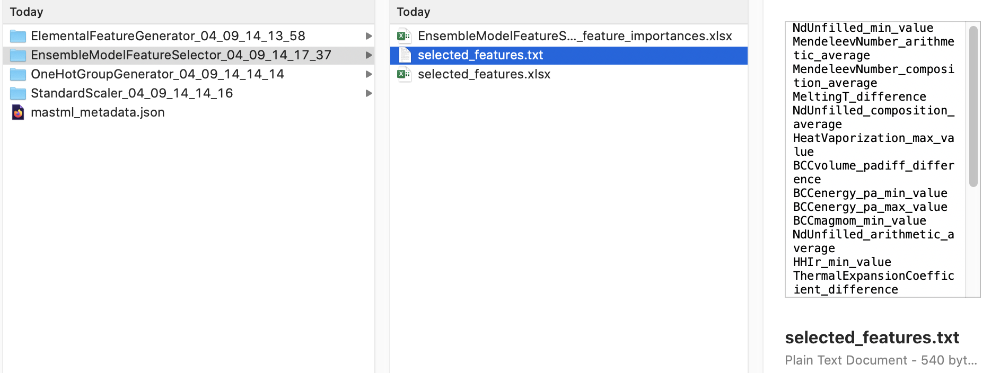

Let's look at our X data once again:

We can see that we now have just 20 columns (features), 
indicating the 20 features that were ranked most highly from
this approach

In [14]:
X

,NdUnfilled_min_value,MendeleevNumber_arithmetic_average,MendeleevNumber_composition_average,MeltingT_difference,BCCenergy_pa_min_value,MeltingT_max_value,HHIr_min_value,HeatVaporization_max_value,BCCenergy_pa_max_value,BCCmagmom_min_value,ElasticModulus_difference,NdUnfilled_composition_average,MendeleevNumber_max_value,NdUnfilled_arithmetic_average,BCCvolume_padiff_difference,HeatFusion_difference,valence_max_value,MiracleRadius_min_value,GSenergy_pa_max_value,IonicRadii_arithmetic_average
0,-0.857637,0.587584,0.587584,-1.276580,0.931053,-1.211603,-0.333888,-1.418039,0.931053,-0.294029,-1.119643,-1.260505,-0.176146,-1.260505,-0.315465,-1.102754,-1.833166,0.859808,0.937419,3.133860
1,0.198447,0.265113,0.265113,-0.564364,0.931053,-0.554667,-0.333888,-0.549465,0.931053,3.811591,-0.067183,-0.495578,-0.176146,-0.495578,-0.315465,-0.709382,-1.194454,-0.730180,0.937419,1.357710
2,0.902504,-0.149493,-0.149493,-0.013905,0.931053,-0.046934,-0.333888,-0.788789,0.931053,-0.294029,0.352156,0.014374,-0.176146,0.014374,-0.315465,-0.324038,0.721682,-0.311762,0.937419,1.251141
3,-0.857637,0.541517,0.541517,-1.112458,0.931053,-1.060219,-0.333888,-1.064931,0.931053,-0.294029,-0.757860,-1.260505,-0.176146,-1.260505,-0.315465,-0.918110,-1.833166,-0.646497,0.937419,1.641894
4,0.550476,0.126911,0.126911,-0.506913,0.931053,-0.501676,-0.333888,-0.717983,0.931053,4.851688,-0.042516,-0.240602,-0.176146,-0.240602,-0.315465,-0.901252,0.721682,-0.730180,0.937419,1.002480
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
403,1.254532,-1.209041,-1.209041,-0.445548,-0.781716,0.655512,0.306424,1.693660,-0.781716,-0.294029,-1.037419,2.309155,-1.993024,2.309155,-0.315465,-0.380234,0.082970,0.776124,-0.787100,0.220974
404,1.606560,-1.162974,-1.162974,0.275928,-0.781716,1.320988,0.306424,2.025739,-0.781716,-0.294029,-0.387855,2.564131,-1.892087,2.564131,-0.315465,0.147206,0.082970,0.943491,-0.787100,0.220974
405,1.958589,-1.393311,-1.393311,-1.026736,-0.781716,-0.111017,-0.227169,0.988435,-0.781716,-0.294029,-0.988085,2.819107,-2.295837,2.819107,-0.315465,-0.552836,-0.555742,0.692440,-0.787100,0.114405
406,1.958589,-1.301176,-1.301176,-0.771548,-0.781716,0.354816,0.306424,1.488111,-0.781716,-0.294029,-0.749637,2.819107,-2.194900,2.819107,-0.315465,-0.605018,-0.555742,2.031377,-0.787100,0.895911


## Task 3.5: Generate learning curves to assess behavior with data and feature number <a name="task35"></a>

We now have our set of 20 selected features, but we can do another piece of 
analysis to help further our understanding of how we may expect a model
to behave with the feature set we have. We can do this by making two types
of learning curves: the first will use our set of 20 features and assess
how well a model performs as a function of amount of training data. This 
learning curve can help assess whether additional training data may result
in improved model performance. The second will use the full training data 
set and assess how well the model performs as more features are added. 
This second learning curve can help one assess whether more or fewer features 
may be needed to optimize model performance.

In [19]:
LearningCurve().evaluate(model=model,
                        X=X,
                        y=y,
                        savepath=savepath,
                        selector=selector,
                        make_new_dir=True)
Xreduced = copy(X)

Let's check what was output- it can be found in the newly created
"LearningCurve_..." folder. The data_learning_curve.png plot shows the
training and validation mean absolute error (MAE) as a function of number
of training data points. We can see this set may benefit from additional
training data, but the validation score isn't changing too much past
about 250 data points.

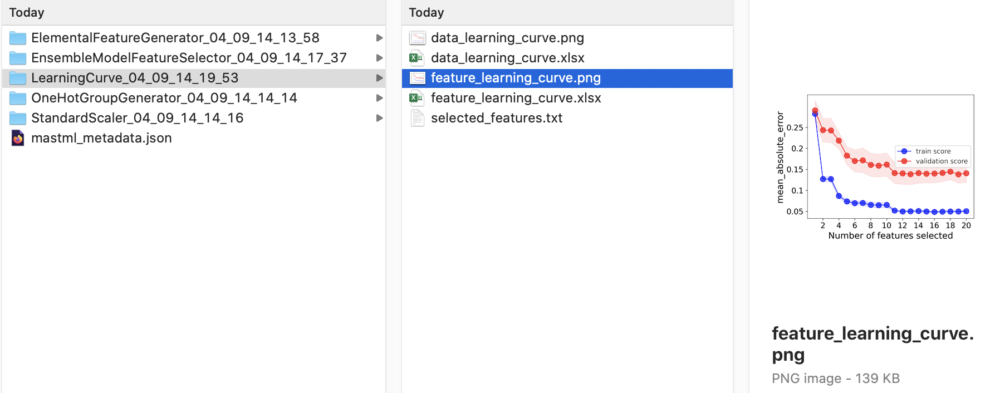


### Data Learning Curve
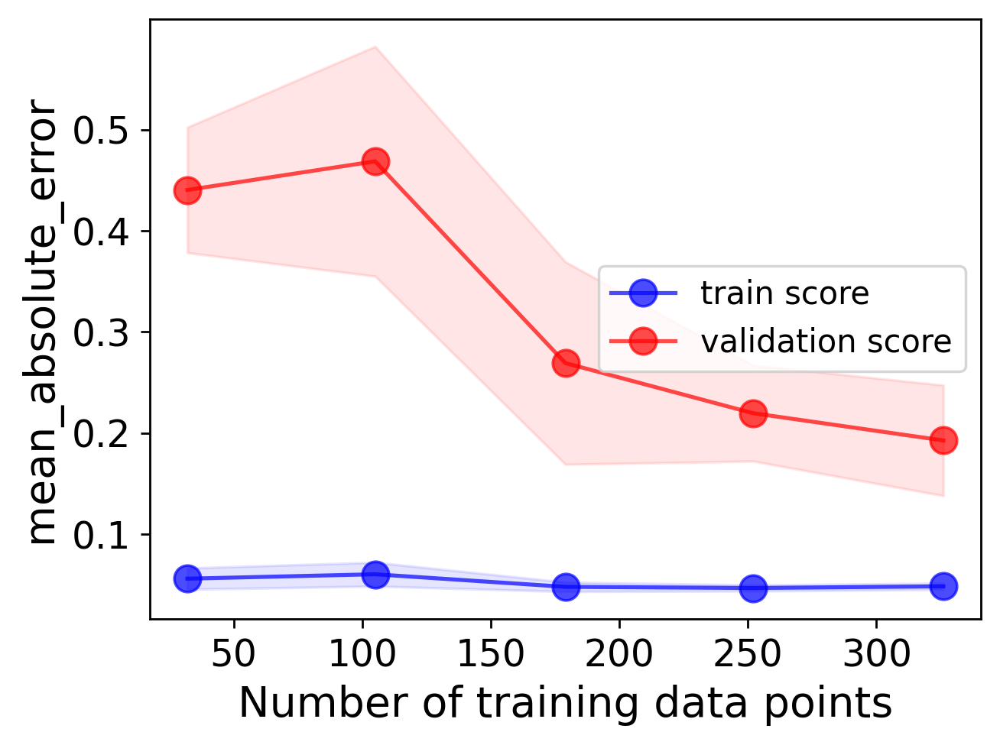

If we look at the feature_learning_curve.png, we see the behavior of the 
model as a function of number of features, from just a single feature
out to the 20 features we selected previously. Here, we can see the
validation score becomes essentially flat after about the 10th feature.
This indicates that we likely only need to use the top 10 features for
our future models.

### Feature Learning Curve
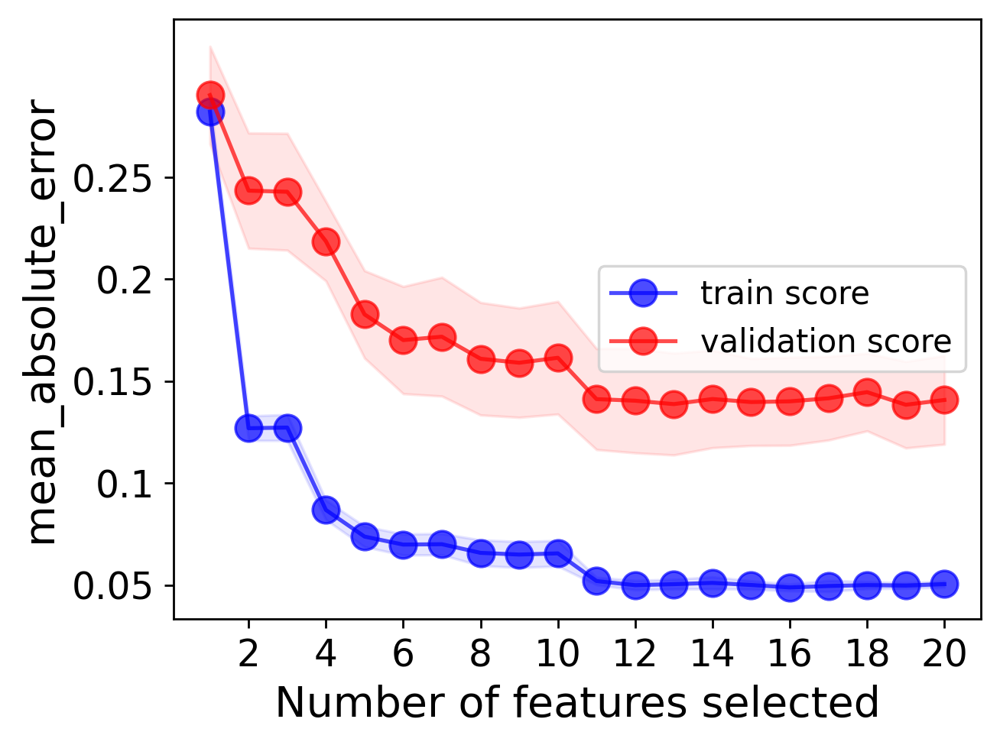

## Task 3.6: Select features using forward selection <a name="task36"></a>

In the previous two tasks, we performed feature selection using ensemble
models. Now, let's try a slightly more time consuming but often more
accurate method- forward selection. We will start with our X data after
performing the first round of feature selection, and this time re-select
the top 10 features. We will perform the learning curve up to 10 features. 
Which method resulted in the lower validation MAE at 10 features? 
Which features did the superior method find resulting in an improved score?

Be patient- this method will take several minutes to complete!

In [15]:
model = SklearnModel(model='RandomForestRegressor')
selector = SklearnFeatureSelector(selector='SequentialFeatureSelector',
                                  estimator=model.model,
                                  n_features_to_select=10)
X = selector.evaluate(X=X, y=y, savepath=savepath, make_new_dir=True)

LearningCurve().evaluate(model=model,
                        X=Xreduced,
                        y=y,
                        savepath=savepath,
                        selector=selector,
                        make_new_dir=True)

### Feature Learning Curve (forward selection)
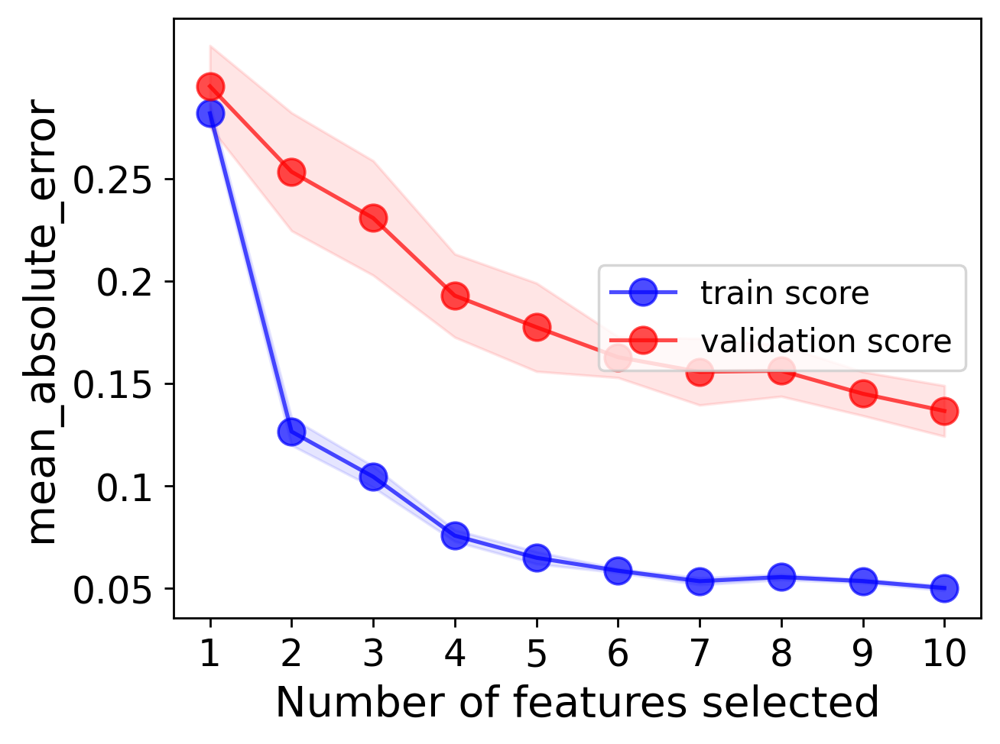

The MAE appears to still be decreasing even at 10 features, while it appeared to start leveling off for the 
previous case of feature selection with an ensemble model. From forward selection, the validation MAE is 0.137 eV, 
while for the ensemble model selection at 10 features the MAE is 0.161 eV. It appears forward selection is doing a better job!

You've now completed your third MAST-ML tutorial notebook! Now that you're more familiar with feature
engineering methods in MAST-ML, the next task is to examine the breadth of models and tests we can perform 
on our data.

The next example in this notebook series is titled MASTML_Tutorial_4_Models_and_Tests.ipynb, and will guide you 
through the process of setting up different types of runs that evaluate a few select model types and perform
different varieties of data split tests.

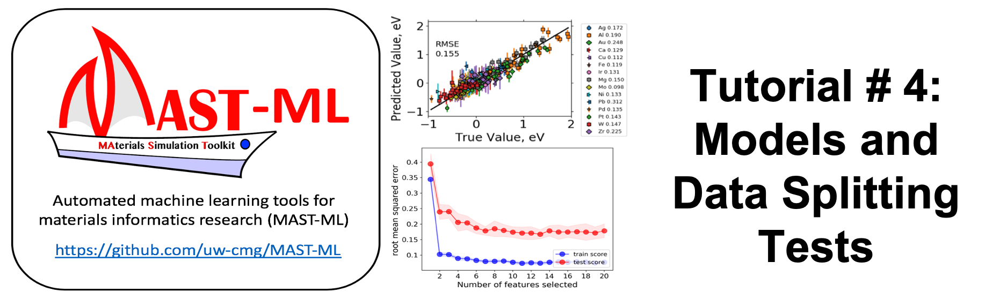

# Tutorial 4: Models and Data Splitting Tests with MAST-ML <a name="tutorial4"></a>

## In this tutorial, we will learn how to run a few different types of models on a select dataset, and conduct a few different types of data splits to evaluate our model performance. In this tutorial, we will:

4.1. [Run a variety of model types from the scikit-learn package](#task41)

4.2. [Run a bootstrapped ensemble of neural networks](#task42)

4.3. [Compare performance of scikit-learn's gradient boosting method and XGBoost](#task43)

4.4. [Compare performance of scikit-learn neural network and Keras-based neural network regressor](#task44)

4.5. [Compare model performance using random k-fold cross validation and leave out group cross validation](#task45)

4.6. [Explore the limits of model performance when up to 90% of data is left out using leave out percent cross validation](#task46)

Here we import the MAST-ML modules used in this tutorial

In [2]:
from mastml.mastml import Mastml
from mastml.datasets import LocalDatasets
from mastml.models import SklearnModel, EnsembleModel
from mastml.preprocessing import SklearnPreprocessor
from mastml.data_splitters import SklearnDataSplitter, NoSplit, LeaveOutPercent
import mastml
import os
data_path = os.path.join(mastml.__path__._path[0], 'data')

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


Figshare is an optional dependency. To import data from figshare, manually install figshare via git clone of git clone https://github.com/cognoma/figshare.git


Using TensorFlow backend.


forestci is an optional dependency. To install latest forestci compatabilty with scikit-learn>=0.24, run pip install git+git://github.com/scikit-learn-contrib/forest-confidence-interval.git


If working on Colab, need to use tensorflow version 1.x. 
If working on NanoHub, can skip this cell as the NanoHub environment uses tensorflow 1.x by default

In [ ]:
%tensorflow_version 1.x

Here, we set the name of the savepath to save MAST-ML results to, and initialize
our MAST-ML run

When the above command is run, a new folder with the name designated SAVEPATH is created.
This is where all of the output for the current MAST-ML run will be saved to.
Note that you can perform multiple runs with the same folder name, and the current datetime
will be appended to the name so that no data is lost or overwritten.

In [3]:
SAVEPATH = 'drive/MyDrive/MASTML_tutorial_4_Models_and_Tests'

mastml = Mastml(savepath=SAVEPATH)
savepath = mastml.get_savepath

drive/MyDrive/MASTML_tutorial_4_Models_and_Tests not empty. Renaming...


## Task 4.1: Run a variety of model types from the scikit-learn package <a name="task41"></a>

In this tutorial, we will again use the diffusion dataset that we examined in the 
previous tutorial. Here, we use the LocalDatasets module to load in the diffusion dataset. 

In [4]:
target = 'E_regression'

extra_columns = ['Material compositions 1', 'Material compositions 2']

d = LocalDatasets(file_path=data_path+'/diffusion_data_selectfeatures.xlsx', 
                  target=target, 
                  extra_columns=extra_columns, 
                  group_column='Material compositions 1',
                  testdata_columns=None,
                  as_frame=True)

# Load the data with the load_data() method
data_dict = d.load_data()

# Let's assign each data object to its respective name
X = data_dict['X']
y = data_dict['y']
X_extra = data_dict['X_extra']
groups = data_dict['groups']
X_testdata = data_dict['X_testdata']

In the first part of this tutorial, we will assess the performance of a handful
of different types of regression models in scikit-learn using full fits and
random 5-fold cross validation. Let's try out the following models:

**Linear regression**
     
**Kernel ridge regression with Gaussian kernel**
     
**Gaussian process regressor**
     
**Random forest regressor**
     
**Neural network**

To make these models, we use the SklearnModel class. The scikit-learn model name 
can just be given as a string matching the model name in the "model" field. The 
remaining arguments are the parameters to pass to the model. If no parameters are given, 
default values are used.

In [10]:
model_lin = SklearnModel(model='LinearRegression')
model_gkrr = SklearnModel(model='KernelRidge', kernel='rbf')
model_gpr = SklearnModel(model='GaussianProcessRegressor', kernel='ConstantKernel*RBF', n_restarts_optimizer=10)
model_rf = SklearnModel(model='RandomForestRegressor', n_estimators=150)
model_nn = SklearnModel(model='MLPRegressor', hidden_layer_sizes=(20, 10))

MAST-ML takes a list of the models as input.

In [11]:
models = [model_lin, model_gkrr, model_gpr, model_rf, model_nn]

As in the previous tutorial, we need to define our preprocessing function. 
We are just going to use the basic StandardScaler in scikit-learn to normalize 
each column to have mean zero and standard deviation of one.

In [9]:
preprocessor = SklearnPreprocessor(preprocessor='StandardScaler', as_frame=True)

Finally, we list which metrics we want to evaluate. If none are given, MAST-ML
will default to evaulating just the root mean squared error. A complete list of 
metrics can be obtained from calling Metrics()._metric_zoo() in metrics.py.

In [10]:
metrics = ['r2_score', 'mean_absolute_error', 'root_mean_squared_error', 'rmse_over_stdev']

As a first run, we want to define and run the case where no data split is 
performed. This represents a full fit to all of the data. MAST-ML will automatically
fit all of our models in sequence.

Note that each splitter.evaluate() method has a verbosity tag- this tag controls 
the extent of analysis output plotting that is performed. A value of 3 is the highest,
meaning that the most output is produced

In [14]:
splitter = NoSplit()
splitter.evaluate(X=X,
                  y=y, 
                  models=models,
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  savepath=savepath,
                  X_extra=X_extra,
                  plots = ['Scatter', 'Histogram'],
                  verbosity=3)

After performing this run, we see from our output folders that a new folder for each
model is created, and we can see that NoSplit was performed based on its naming convention.
Note there is only one split folder for these runs because no data split was performed, i.e.
all data was used as train and test

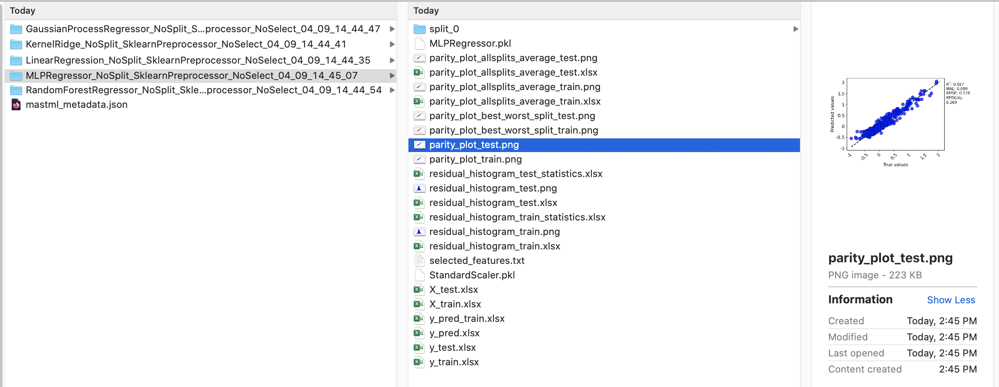

Next, we want to do something a bit more informative than simply fitting to 
all of our data. We will do a random leave-out cross validation test (5-fold CV). 
MAST-ML will output data and plots for each split as well as some more comprehensive analysis 
performed over all splits. The saved model and preprocessor corresponding to the best 
split will also be put in the data splitter parent directory, and this saved model
can be imported for use in future predictions 

In [15]:
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=models,
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  verbosity=3)

MAST-ML saves output with a folder format of ModelName_DataSplitterName_PreprocessorName_FeatureSelectorName_Datetime
Examine the output of each model for the 5-fold CV runs. You'll see there are folders corresponding to each
split that was performed. In each of these split folders, the X and y train/test splits are saved as spreadsheets,
as well as the preprocessed data used for fitting. In addition, data on the residuals, a residuals histogram, and 
parity plots for both train and test data are provided. There are also some files pertaining to the estimated model
errors for certain models (GPR, Random forest), but we'll discuss those more in Tutorial 6. 

In the main data splitter directory, there are summary-level plots of residual histograms and data over all splits,
and train and test parity plots, again taken over all splits. There are a few varieties of parity plots that may
be of interest:

**parity_plot_allsplits_average_(train/test).png**: This plot is pred vs. true values, one point per unique true data point. The average test value of each point is plotted, so leaving out the same point multiple times gives an error bar.

**parity_plot_best_worst_eachpoint_(train/test).png**: Parity plot where each point is the best or worst prediction over all the splits for that particular data point.

**parity_plot_best_worst_split_(train/test).png**: Parity plot where the data series pertain to the best and worst individual splits.

**parity_plot_(train/test).png**: Parity plot showing all the data points from all splits, without averaging values for each unique true data point.



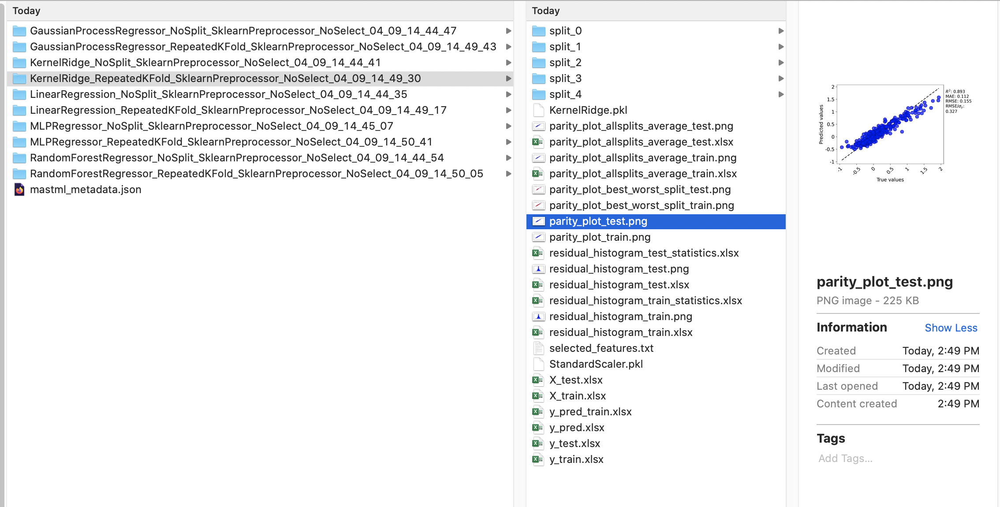

Which model performed the best? We can look at the test data parity plots of each model to see:

### Gaussian Process Regression
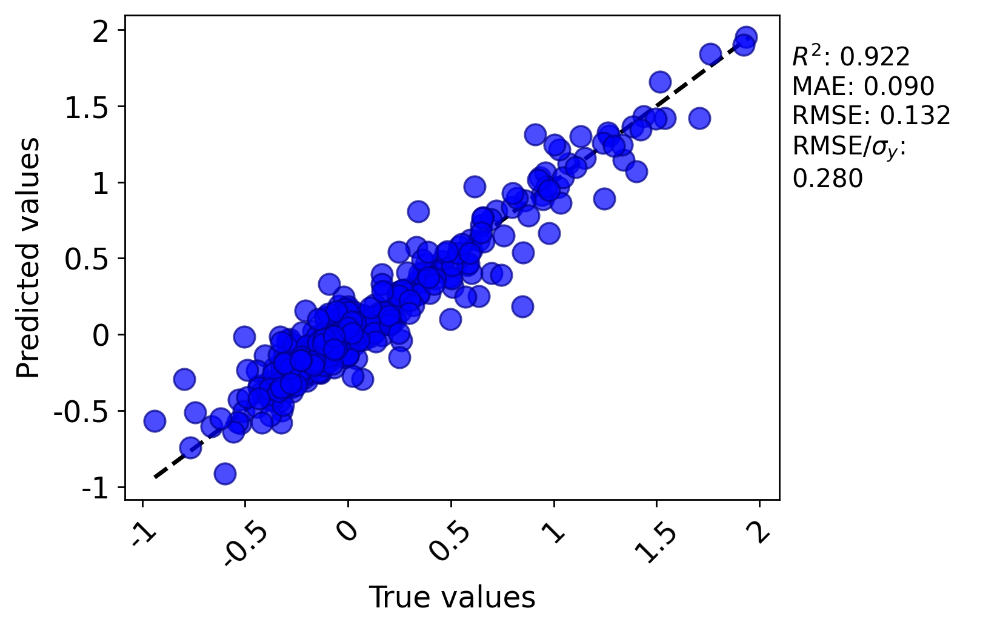

### Kernel Ridge Regression
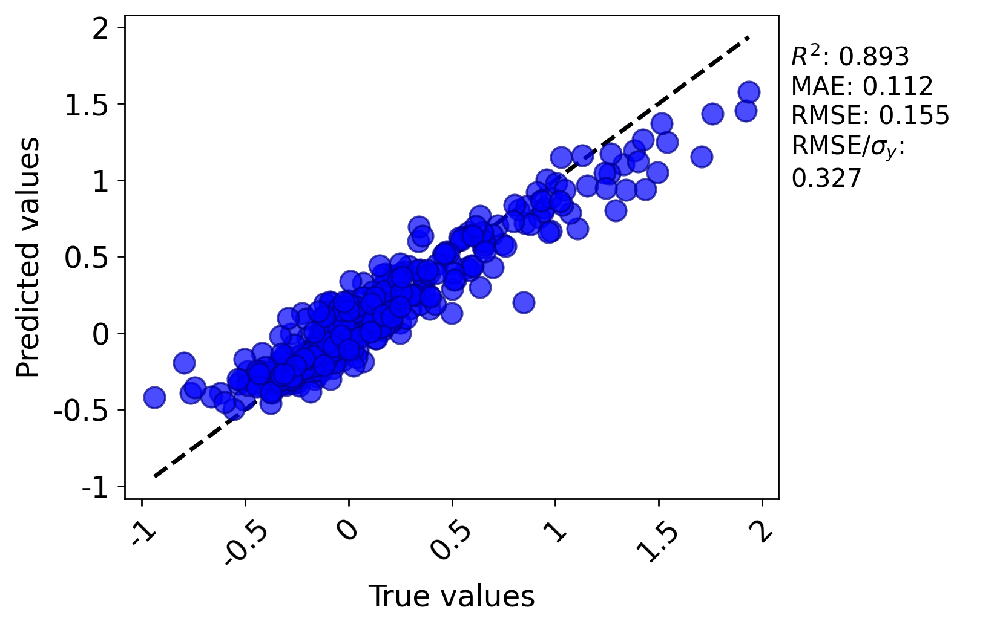

### Linear Regression
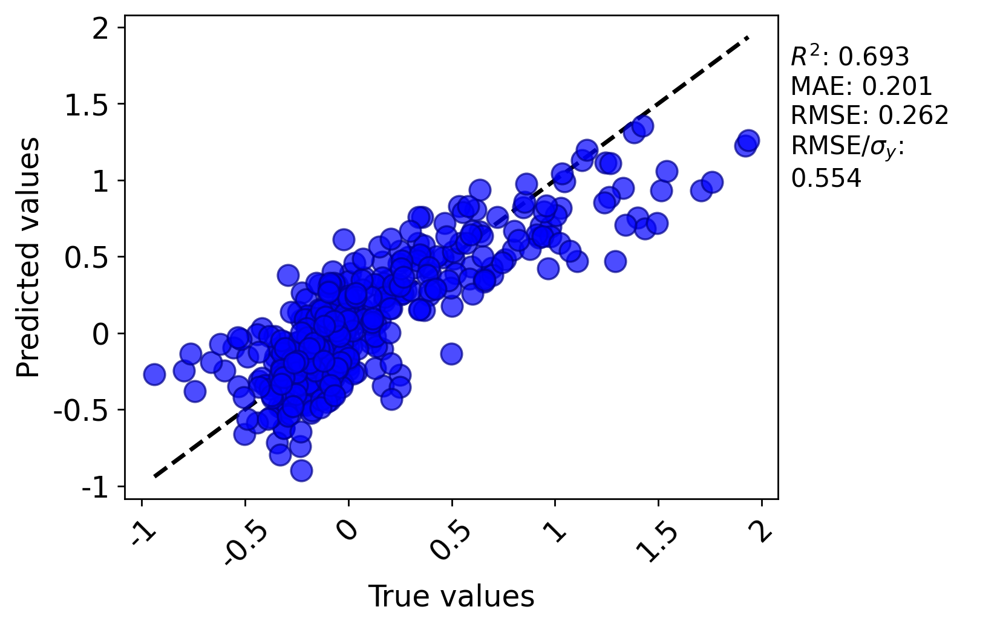

### Neural Network
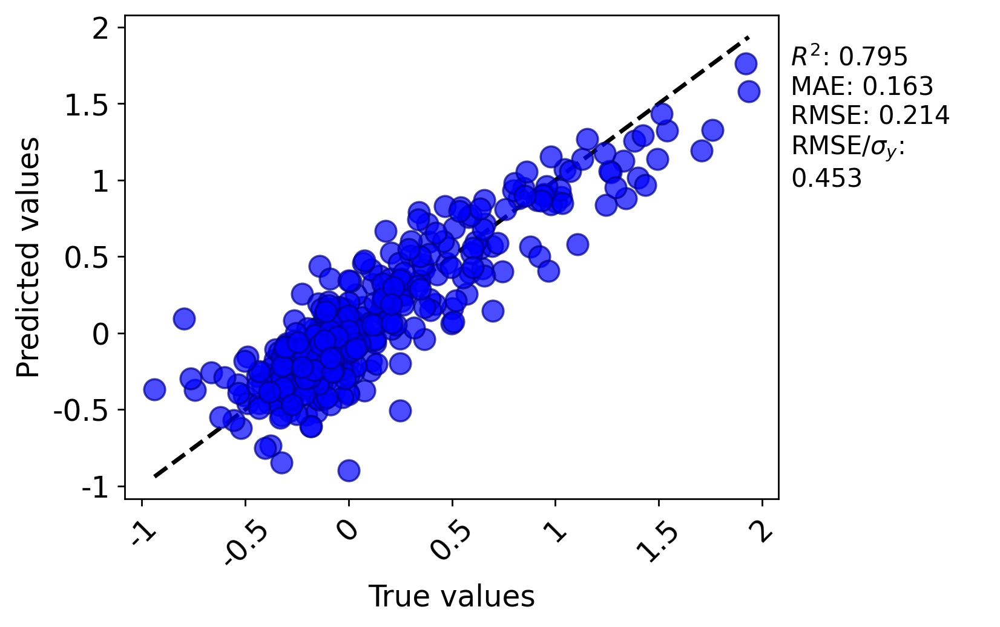

### Random Forest
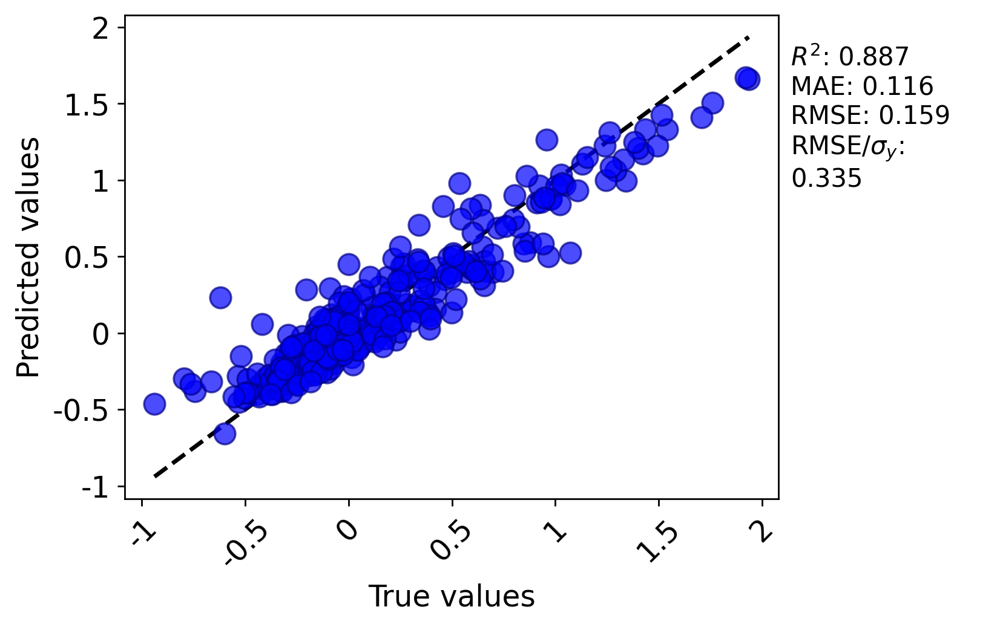


I found that GPR had the lowest average test RMSE of just 0.155 eV, with Random forest in close second at 0.159 eV.

## Task 4.2: Run a bootstrapped ensemble of neural networks <a name="task42"></a>

We just finished running a number of different types of models. One other type of 
flexible and quite generally powerful model is a bootstrapped ensemble model. We
previously already ran one of these- the random forest, which is a bootstrapped ensemble
of decision trees. However, we can create other types of bootstrap ensembles models
using the EnsembleModel() in MAST-ML. Here, let's build an ensemble of neural network models. We will explore the implications of using ensemble models for uncertainy
quantification in more detail in Tutorial 6.

Like the SklearnModel, we denote the model name as its string name (here: "MLPRegressor"); this is
the base estimator in our ensemble. Here, we will use 100 separate neural network models in our 
ensemble

In [16]:
model_ens = EnsembleModel(model='MLPRegressor', n_estimators=100, hidden_layer_sizes=(20, 10))

Let's perform random 5-fold cross validation with our new ensemble model.

In [17]:
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_ens],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  verbosity=3)

How does the ensemble of neural networks compare to the single neural network? From our previous set
of parity plots, we saw that the neural network had an RMSE of 0.214 eV. From this ensemble model
run, we see that the RMSE has dropped to just 0.153 eV! 

### Single Neural Network
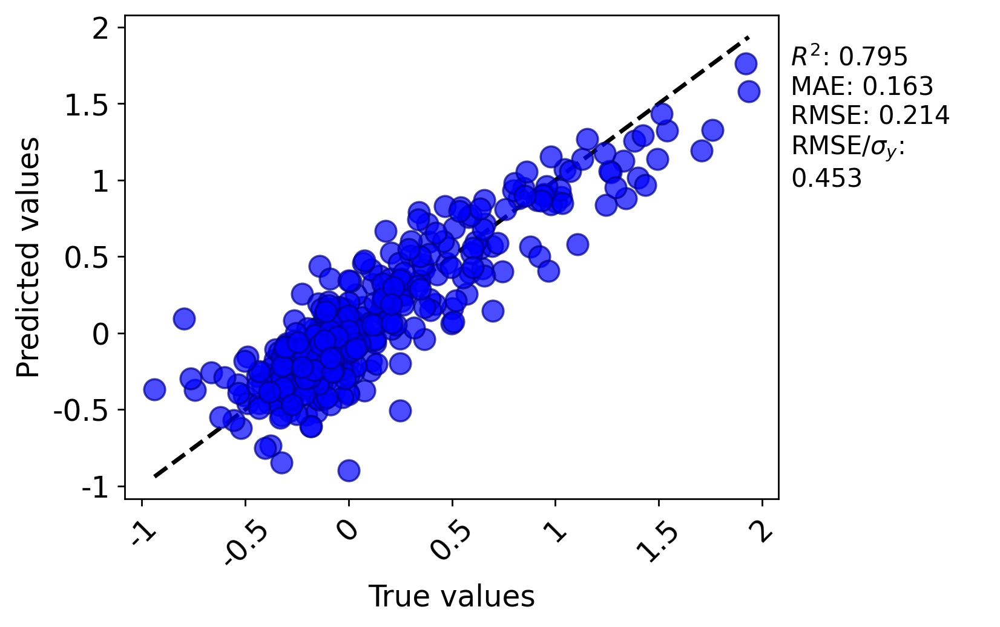

### Ensemble of Neural Networks

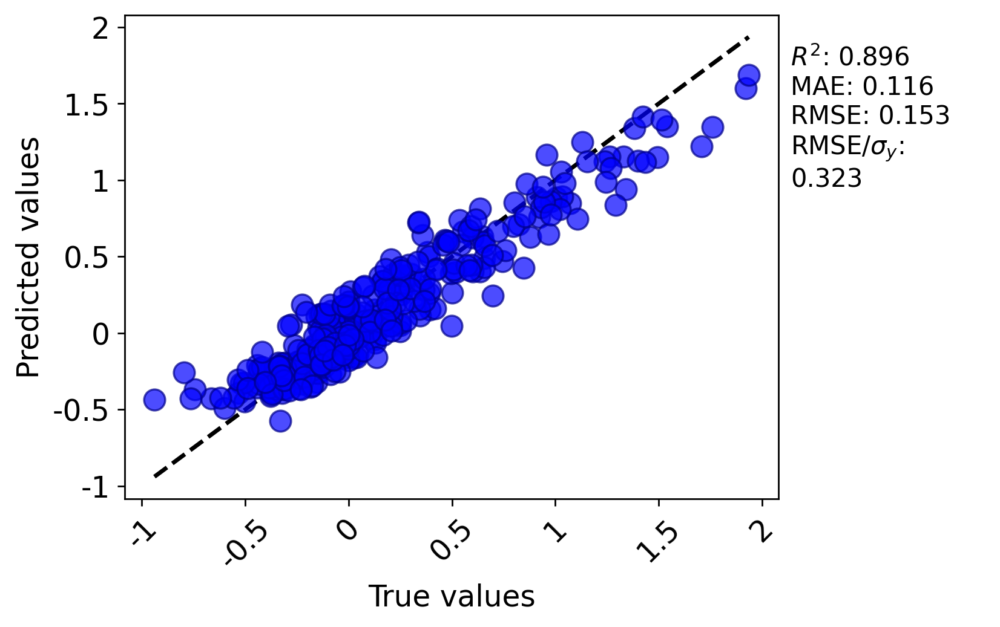

## Task 4.3: Compare performance of scikit-learn's gradient boosting method and XGBoost <a name="task43"></a>

Gradient boosted trees are a very popular type of regression model, and often are on par
or out-perform other tree-based methods. MAST-ML supports both scikit-learn's gradient
boosted regression model and the extreme boosting method in the XGBoost package. Let's run
5-fold cross validation test on each model and see which performs better! Do either of
the gradient boosting methods perform better than the random forest model you ran earlier?

In [18]:
model_gbr = SklearnModel(model='GradientBoostingRegressor', n_estimators=150)
model_xgb = SklearnModel(model='XGBoostRegressor', n_estimators=150)
models = [model_gbr, model_xgb]

splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=models,
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  verbosity=3)

[22:37:10] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:37:13] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:37:16] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:37:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:37:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


Let's see how the two models performed:

### Gradient boosting regression:
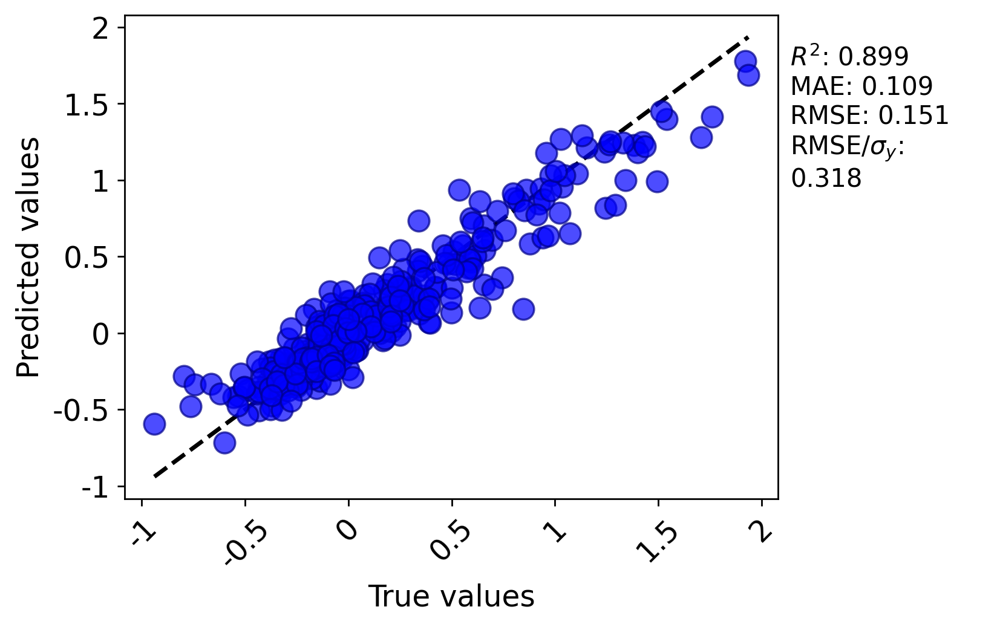

### XGBoost:
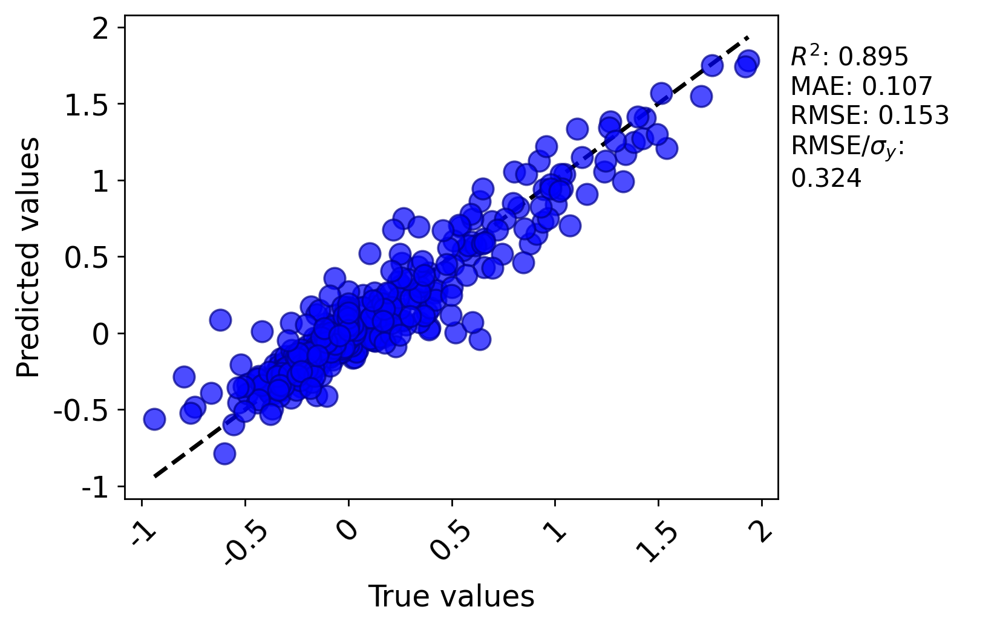

I found that GBR and XGB performed about the same- with test RMSE of about 0.150 eV. Both
of these models outperformed the random forest from earlier- which I found to have RMSE of 0.161 eV!

## Task 4.4: Compare performance of scikit-learn neural network and Keras-based neural network regressor <a name="task44"></a>

Due to their versatility and power, neural networks are among the most commonly used
regression models today. MAST-ML supports creating neural networks both from scikit-learn
and from Keras. We already ran the scikit-learn variant earlier, and it can be created with
a single line call:

In [5]:
model_nn = SklearnModel(model='MLPRegressor', hidden_layer_sizes=(20, 10))

Creating a Keras-based neural network for use in MAST-ML is a little more complicated, but can 
still be done with just a handful of lines. Keras offers the ability to make its models function
like scikit-learn models, so we use that functionality here.

In [6]:
# Import a few needed modules from Keras to build the network
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasRegressor

# We need to define the function that builds the network architecture
def keras_model():
    model = Sequential()
    model.add(Dense(20, input_dim=20, kernel_initializer='normal', activation='relu'))
    model.add(Dense(10, kernel_initializer='normal', activation='relu'))
    model.add(Dense(1, kernel_initializer='normal'))
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

Now we build the keras model that will be passed into MAST-ML. The build_fn parameter
designates the "build function", i.e. the function used to build the network architecture,
which we defined above.

In [7]:
model_keras = KerasRegressor(build_fn=keras_model, epochs=100, batch_size=100, verbose=0)

Now that we've built both of our model types, we can run each of them using
our random 5-fold cross validation test. 

In [ ]:
models = [model_nn, model_keras]
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=models,
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  verbosity=3)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.



Which neural network performs better? Let's examine the parity plots for each:

### Scikit-learn Neural Network:
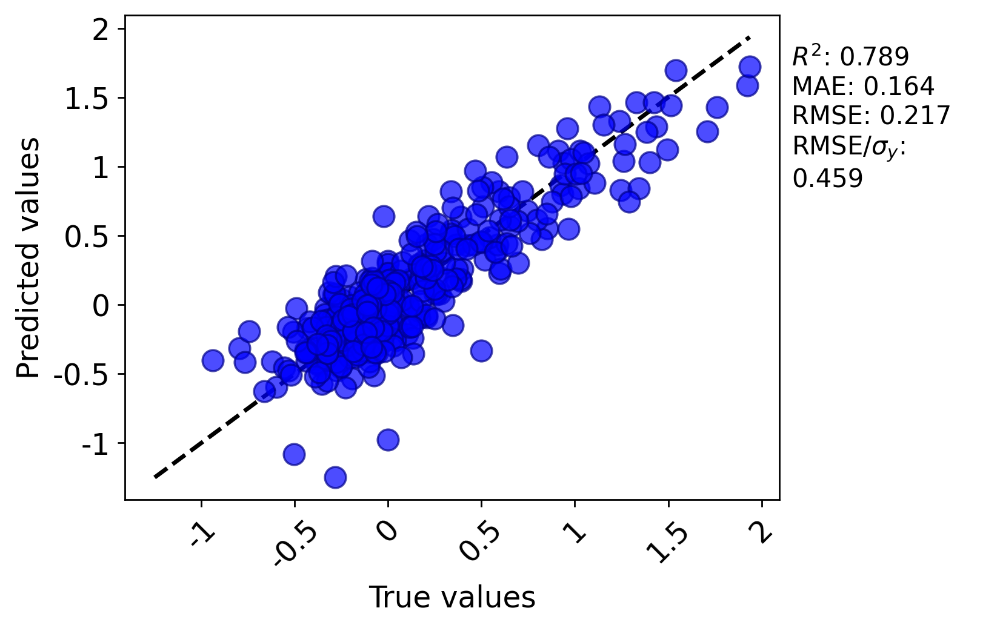

### Keras Neural Network:
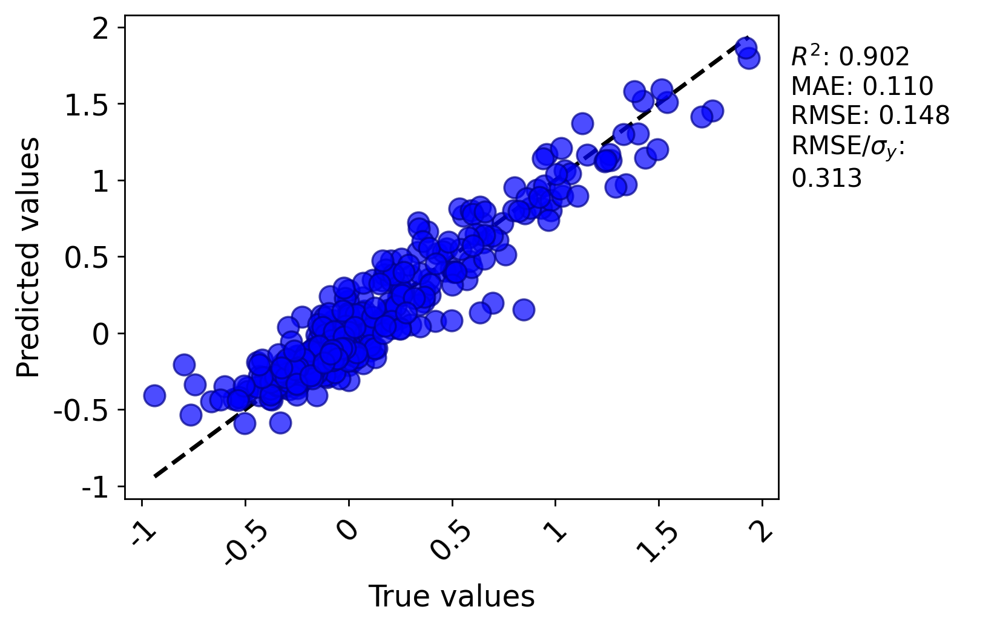
    
In my test, it was no contest. The scikit-learn MLPRegressor had a test RMSE of 0.217 eV while the Keras network had an RMSE of only 0.148 eV!

## Task 4.5: Compare model performance using random k-fold cross validation and leave out group cross validation <a name="task45"></a>

So far we have only done two types of data splitter test: the most basic test where no split is
performed and we fit to all the data, and a random leave-out cross validation test. However,
many datasets have subsets of data that belong to distinct groups, and one is often interested in
how a model may perform when predicting new data on a brand new group. The diffusion data has
logical set of groups based on the host metal element, which is denoted in the 'Material compositions 1'
column of our data set and is designated in the groups variable when we imported the data. There are
15 unique groups (metal hosts) in our current case:

In [23]:
import numpy as np
np.unique(groups)

array(['Ag', 'Al', 'Au', 'Ca', 'Cu', 'Fe', 'Ir', 'Mg', 'Mo', 'Ni', 'Pb',
       'Pd', 'Pt', 'W', 'Zr'], dtype=object)

Let's focus on using a random forest model and use this model to run two tests:
random 5-fold cross validation and leave out group cross validation:

In [24]:
model_rf = SklearnModel(model='RandomForestRegressor', n_estimators=150)
splitter_random = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter_groups = SklearnDataSplitter(splitter='LeaveOneGroupOut')

splitter_random.evaluate(X=X, 
                         y=y, 
                         models=[model_rf],
                         mastml=mastml,
                         preprocessor=preprocessor,
                         metrics=metrics,
                         plots=['Scatter', 'Histogram'],
                         savepath=savepath,
                         X_extra=X_extra,
                         verbosity=3)

splitter_groups.evaluate(X=X, 
                         y=y, 
                         groups=groups,
                         models=[model_rf],
                         mastml=mastml,
                         preprocessor=preprocessor,
                         metrics=metrics,
                         plots=['Scatter', 'Histogram'],
                         savepath=savepath,
                         X_extra=X_extra,
                         verbosity=3)

Which test resulted in the higher error? Why do you think this is the case?

### Random leave-out:
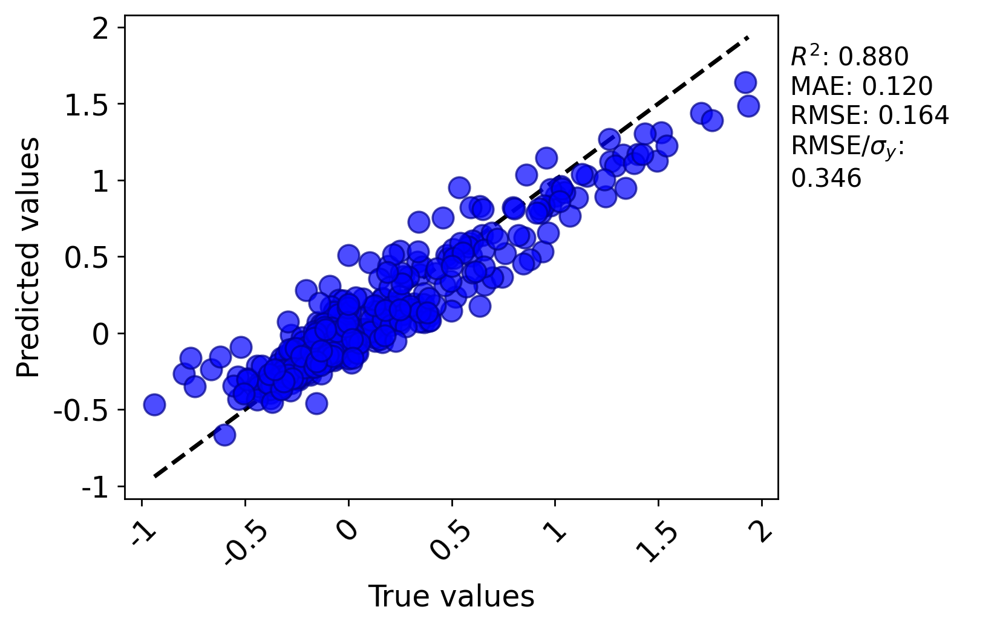

### Leave out group:
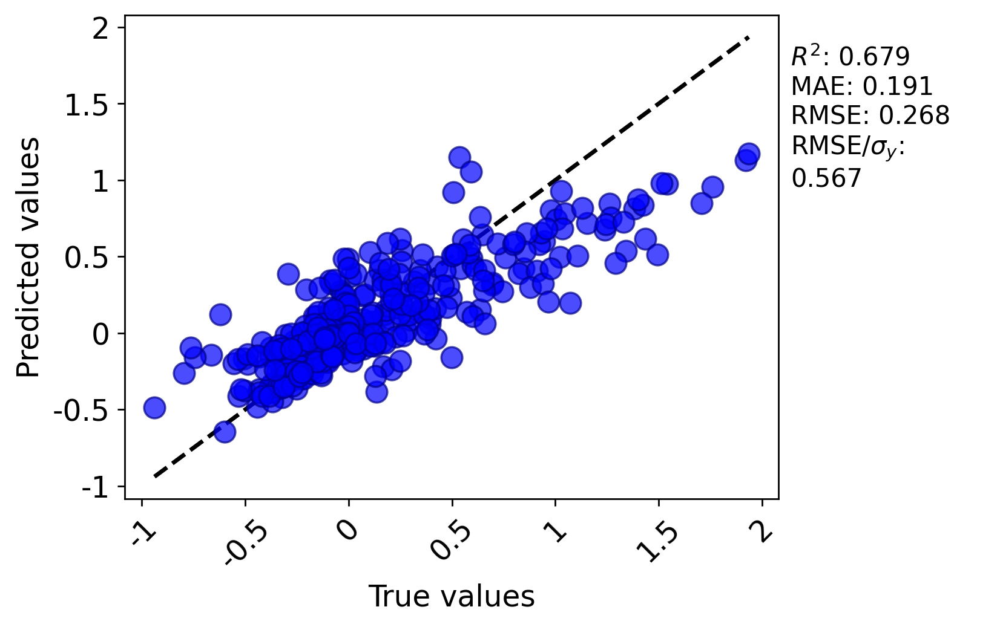

I found that the leave out group splitter had a higher error with a test
RMSE of about 0.268 eV compared to 0.164 eV for the random cross validation test.

For leave out group tests, MAST-ML also provides plots of each error metric value vs. group. From this, we can 
see that Mo had the best fit while Zr and Pt had rather poor fits.

### RMSE vs Group:
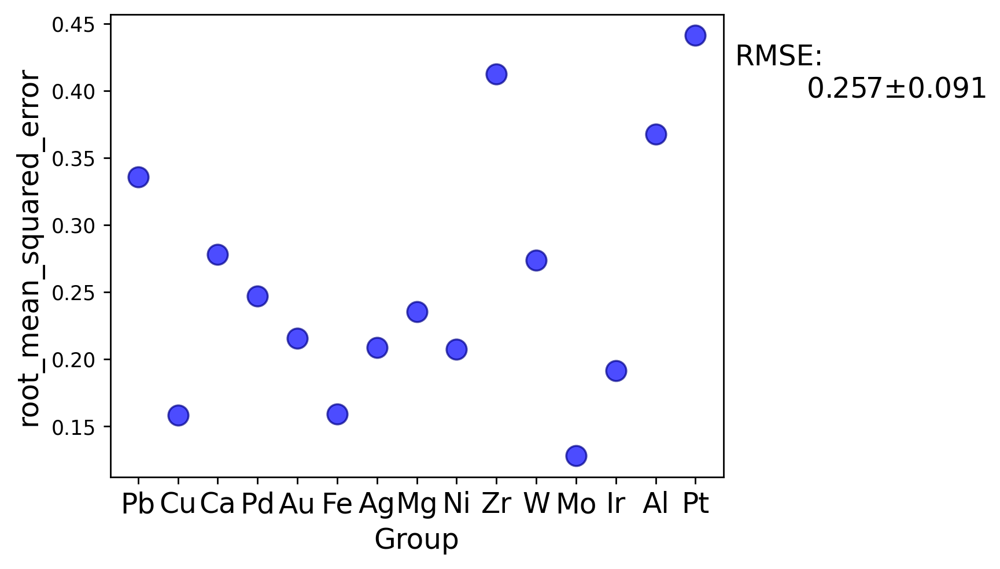


## Task 4.6: Explore the limits of model performance when up to 90% of data is left out using leave out percent cross validation <a name="task46"></a>

As one final data splitter test in this tutorial, we can see how well (or poorly) our
model performs as we hold out more and more data. Typical K-fold CV only allows for 
holding out up to 50% of the data (2-fold CV). Here, we use LeaveOutPercent to leave
out up to 90% of our data. Let's define several increments of different leave out percent
tests, then fit a Kernel ridge model to each and see how the test RMSE changes as more
data is left out:

In [25]:
model_gkrr = SklearnModel(model='KernelRidge', kernel='rbf')

splitter_10percent = LeaveOutPercent(percent_leave_out=0.1, n_repeats=5)
splitter_25percent = LeaveOutPercent(percent_leave_out=0.25, n_repeats=5)
splitter_50percent = LeaveOutPercent(percent_leave_out=0.5, n_repeats=5)
splitter_75percent = LeaveOutPercent(percent_leave_out=0.75, n_repeats=5)
splitter_90percent = LeaveOutPercent(percent_leave_out=0.9, n_repeats=5)

splitter_10percent.evaluate(X=X,
                            y=y, 
                            models=[model_gkrr],
                            mastml=mastml,
                            preprocessor=preprocessor,
                            metrics=metrics,
                            plots=['Scatter', 'Histogram'],
                            savepath=savepath,
                            X_extra=X_extra,
                            verbosity=3)
splitter_25percent.evaluate(X=X,
                            y=y, 
                            models=[model_gkrr],
                            mastml=mastml,
                            preprocessor=preprocessor,
                            metrics=metrics,
                            plots=['Scatter', 'Histogram'],
                            savepath=savepath,
                            X_extra=X_extra,
                            verbosity=3)
splitter_50percent.evaluate(X=X,
                            y=y, 
                            models=[model_gkrr],
                            mastml=mastml,
                            preprocessor=preprocessor,
                            metrics=metrics,
                            plots=['Scatter', 'Histogram'],
                            savepath=savepath,
                            X_extra=X_extra,
                            verbosity=3)
splitter_75percent.evaluate(X=X,
                            y=y, 
                            models=[model_gkrr],
                            mastml=mastml,
                            preprocessor=preprocessor,
                            metrics=metrics,
                            plots=['Scatter', 'Histogram'],
                            savepath=savepath,
                            X_extra=X_extra,
                            verbosity=3)
splitter_90percent.evaluate(X=X,
                            y=y, 
                            models=[model_gkrr],
                            mastml=mastml,
                            preprocessor=preprocessor,
                            metrics=metrics,
                            plots=['Scatter', 'Histogram'],
                            savepath=savepath,
                            X_extra=X_extra,
                            verbosity=3)

How does the test RMSE change as more data is left out? For my case, I found the following:

LO 10%: 0.148 eV 

LO 25%: 0.155 eV

LO 50%: 0.183 eV
    
LO 75%: 0.216 eV

LO 90%: 0.282 eV

Not surprisingly, the model becomes worse as less data is used for training. The minimum amount
of data needed to obtain what constitutes good model performance will be application specific.

You've now completed your fourth MAST-ML tutorial notebook! Now that you're more familiar with working
with different types of models and cross validation tests to evaluate those models, we are ready to 
move on to some more advanced fitting methods, like nested cross validation and model optimization

The next example in this notebook series is titled MASTML_Tutorial_5_NestedCV_and_OptimizedModels.ipynb, 
and will guide you through the process of assessing model performance on true test data, and generating the
best optimized model for a specified cross validation test

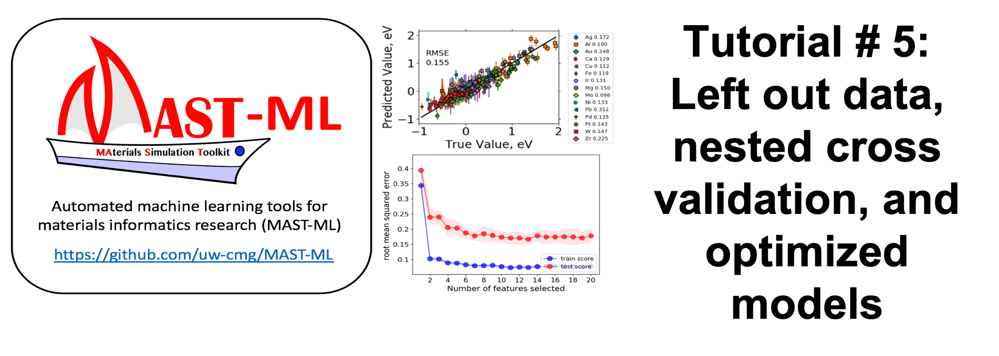

# Tutorial 5: Left out data, nested cross valiation, and optimized models with MAST-ML <a name="tutorial5"></a>

## In this tutorial, we will perform more advanced model fitting routines, including nested cross validation and hyperparameter optimization. In this tutorial, we will learn how to use MAST-ML to:

5.1. [Assess performance on manually left-out test data](#task51)

5.2. [Perform nested cross validation to assess model performance on unseen data](#task52)

5.3. [Optimize the hyperparameters of our models to create the best model](#task53)


Here we import the MAST-ML modules used in this tutorial

In [2]:
from mastml.mastml import Mastml
from mastml.datasets import LocalDatasets
from mastml.models import SklearnModel
from mastml.preprocessing import SklearnPreprocessor
from mastml.data_splitters import SklearnDataSplitter, NoSplit
from mastml.hyper_opt import GridSearch, RandomizedSearch, BayesianSearch
import numpy as np
import mastml
import os
data_path = os.path.join(mastml.__path__._path[0], 'data')

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


Figshare is an optional dependency. To import data from figshare, manually install figshare via git clone of git clone https://github.com/cognoma/figshare.git
forestci is an optional dependency. To install latest forestci compatabilty with scikit-learn>=0.24, run pip install git+git://github.com/scikit-learn-contrib/forest-confidence-interval.git


Here, we set the name of the savepath to save MAST-ML results to, and initialize
our MAST-ML run

When the above command is run, a new folder with the name designated SAVEPATH is created.
This is where all of the output for the current MAST-ML run will be saved to.
Note that you can perform multiple runs with the same folder name, and the current datetime
will be appended to the name so that no data is lost or overwritten.

In [3]:
SAVEPATH = 'drive/MyDrive/MASTML_tutorial_5_NestedCV_and_OptimizedModels'

mastml = Mastml(savepath=SAVEPATH)
savepath = mastml.get_savepath

## Task 5.1: Assess performance on manually left-out test data <a name="task51"></a>

In this tutorial, we will see there are two ways to evaluate models in
a "two-level" fashion, i.e. where we split data into train/leftout data, 
then build and evaluate models with a cross validation data splitter on
the training set to build various sub train/test splits. This is also
commonly called nested cross validation. The leftout data is never used 
in training at any point, so can function as a good approximation for
how the model may perform on new, unseen data.

MAST-ML offers two methods to do this. The first is for the user to specify 
specific data points in the imported data that should be reserved as left-out
data. The second method is to perform an automatic nested cross-validation scheme.
Here, we will showcase the first method where some data points are manually
selected to function as left-out data.

In this tutorial, we will again use the diffusion dataset that we examined in the 
previous tutorials. Here, we use the LocalDatasets module to load in the diffusion dataset. 
We are using the diffusion_data_leaveoutPt.xlsx file as it contains a column denoting
the data to leave out (those with Pt as the host element)

To specify which data points are left out, we made a new column in the data file (it can
have whatever name you want), and then label 0 if the data is not left out data and 1
if the data is to be used as left-out data. For this example we are using all data where
Pt is the host element as left out data.

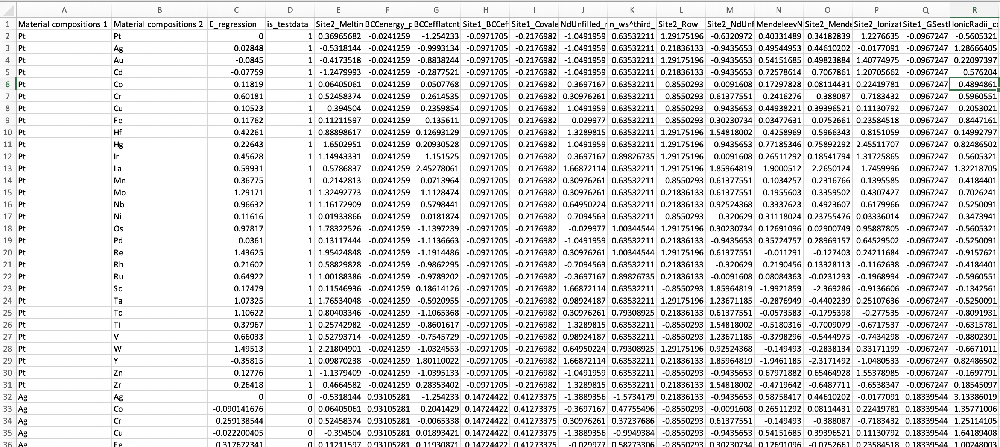

In [4]:
target = 'E_regression'

extra_columns = ['Material compositions 1', 'Material compositions 2', 'is_testdata']

# testdata_columns: column names denoting left-out data to evaluate using best
#   model from CV tests. This is manual way to leave out data. In our current case, 
#   the column called "is_testdata" denotes which points will be left out
#   as_frame: whether to return data as dataframe. Want this to be true.
d = LocalDatasets(file_path=data_path+'/diffusion_data_leaveoutPt.xlsx', 
                  target=target, 
                  extra_columns=extra_columns, 
                  group_column='Material compositions 1',
                  testdata_columns=['is_testdata'],
                  as_frame=True)

# Load the data with the load_data() method
data_dict = d.load_data()

# Let's assign each data object to its respective name
X = data_dict['X']
y = data_dict['y']
X_extra = data_dict['X_extra']
groups = data_dict['groups']
X_testdata = data_dict['X_testdata']

We have one left out data set in this example, so X_testdata is a list with an array containing
the indices of the left out data, which will be automatically used in our data splitter. We
see there are 30 left out data points, which correspond to the number of points where Pt is the
host element

In [5]:
X_testdata[0].shape

(30,)

We are going to primarily be evaluating Kernel ridge models in this tutorial. Let's build 
and run a Kernel ridge model using random 5-fold cross validation, where we also specify
our X_testdata in the splitter evaluate() method (as the leaveout_inds parameter),
so that it knows to predict the values of the left out data.

In [6]:
model_krr = SklearnModel(model='KernelRidge', kernel='rbf')
preprocessor = SklearnPreprocessor(preprocessor='StandardScaler', as_frame=True)
metrics = ['r2_score', 'mean_absolute_error', 'root_mean_squared_error', 'rmse_over_stdev']
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_krr],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  leaveout_inds=X_testdata,
                  verbosity=3)

When we examine our output directory, we see that now there is a new "split_outer_0"
directory, and within that directory reside the individual split directories we have
seen from previous tutorials. There is one split outer directory because there was one
set of left-out data. For this split_outer_0 directory, the Pt host data are left out, and
random 5-fold CV is performed on the remaining data to assess model performance

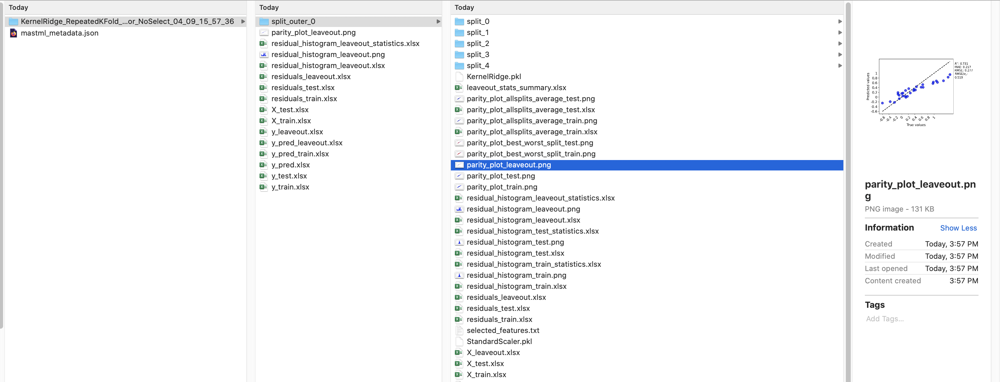

How did the model do with predicting the Pt data? 

### Pt left out data parity plot:
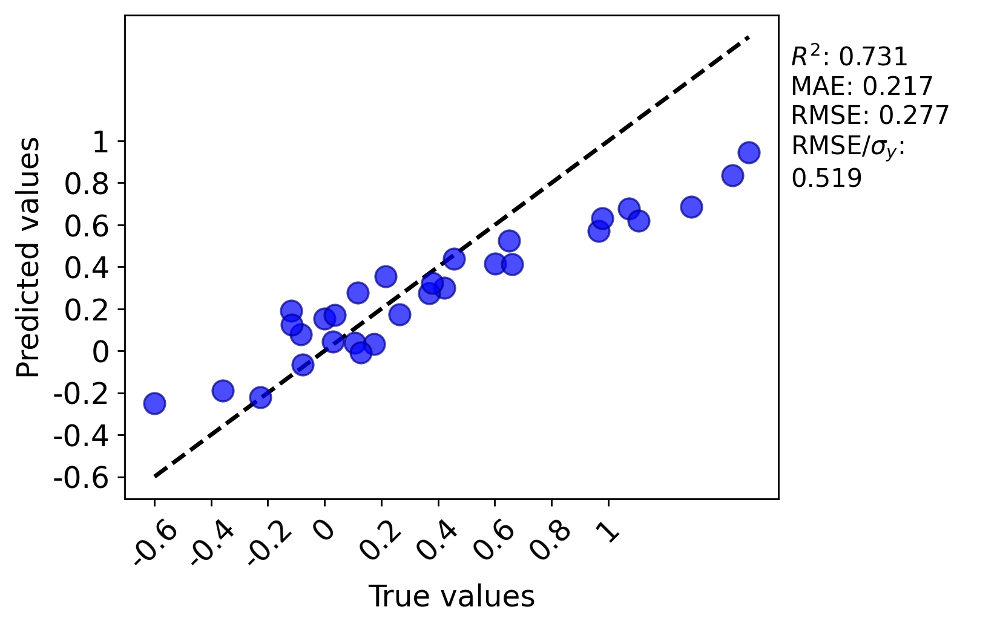

### Parity plot of test data in random CV:
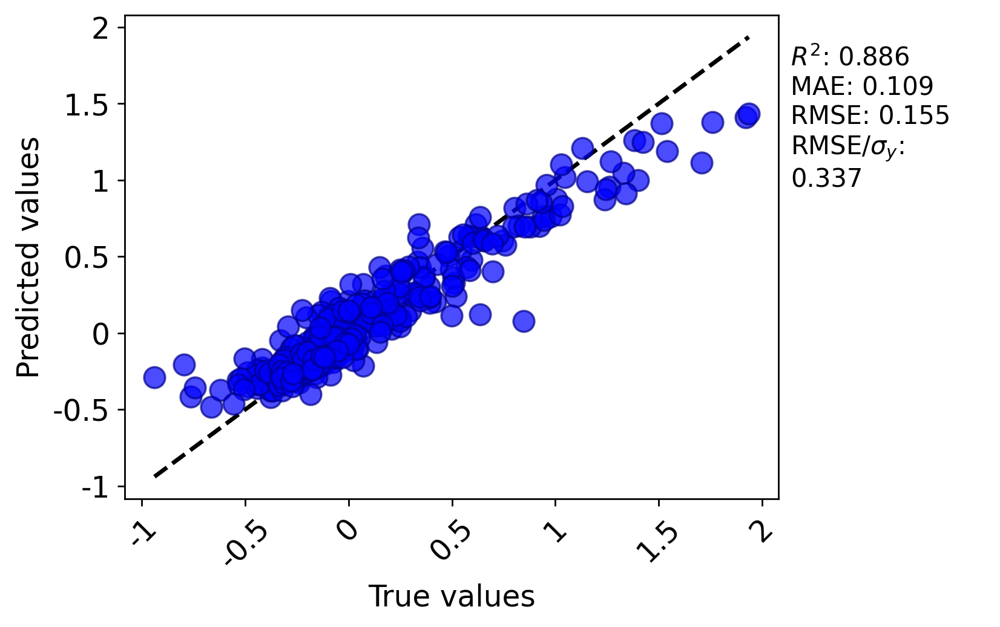


My model got an RMSE of 0.277 eV, while the 5-fold RMSE on the remaining data was 0.155 eV. The prediction of Pt was higher than 
this value because random 5-fold CV is an overly optimistic predictor of model performance
when predicting the values of unseen data from a new group!

## Task 5.2: Perform nested cross validation to assess model performance on unseen data <a name="task52"></a>

Instead of just manually specifying which data should be left-out data, we can have MAST-ML
do this automatically via nested cross validation. Any data splitter can be used to perform
nested cross validation. Here, we will perform nested CV with our kernel ridge method using
both 5-fold and leave out group cross validation. Then, we can compare how our previous result
of predicting on Pt compares to the left-out data RMSE values from 5-fold and leave out group
tests. 

This time, we are not specifying the leaveout_inds parameter. To use nested CV,
we set nested_CV=True in the evaluate method. The data splitter method is repeated
for each nesting level, so here we are doing 1 cycle of 5-fold CV. That means that there
will be 5 level 1 splits, and 5 level 2 splits for each of the level 1 split, making for 
a total of 5*5 = 25 splits. 

In [7]:
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_krr],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  nested_CV=True,
                  verbosity=3)

For leave out group, recall we need to set the groups parameter in the evaluate method.
When doing nested CV with leave out group, the total number of splits will be n_groups*n_groups,
so in our case that is 125 splits (be patient- this run will take about 10 minutes or so). Here, we
turn the verbosity down to 1, which will only make plots for the left out data series. This will speed
the run up a bit!

In [ ]:
splitter = SklearnDataSplitter(splitter='LeaveOneGroupOut')
splitter.evaluate(X=X,
                  y=y, 
                  groups=groups,
                  models=[model_krr],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  nested_CV=True,
                  verbosity=1)

### Nested random cross validation:
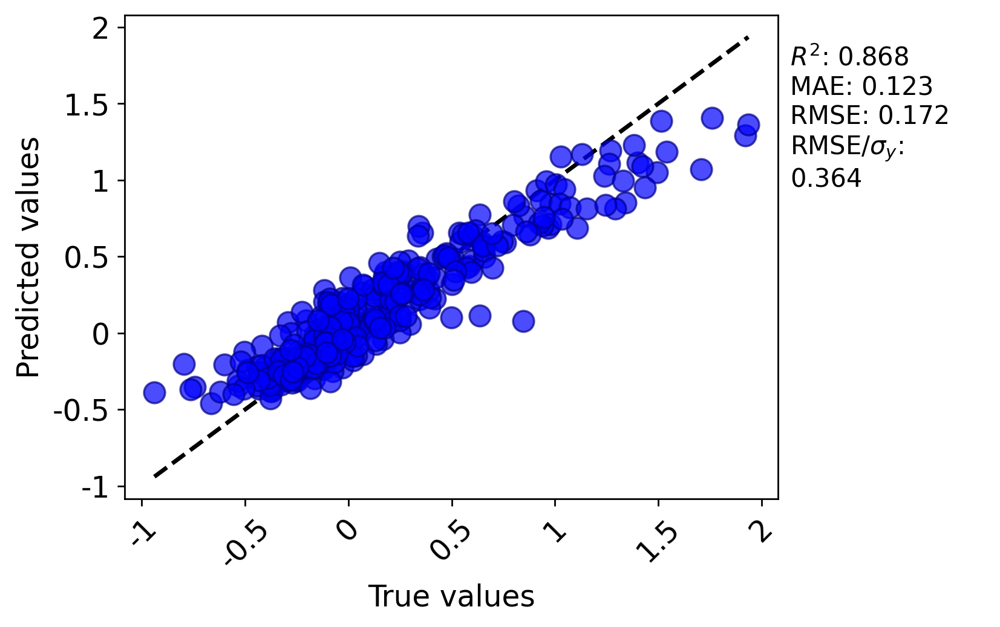

### Nested leave out group cross validation:
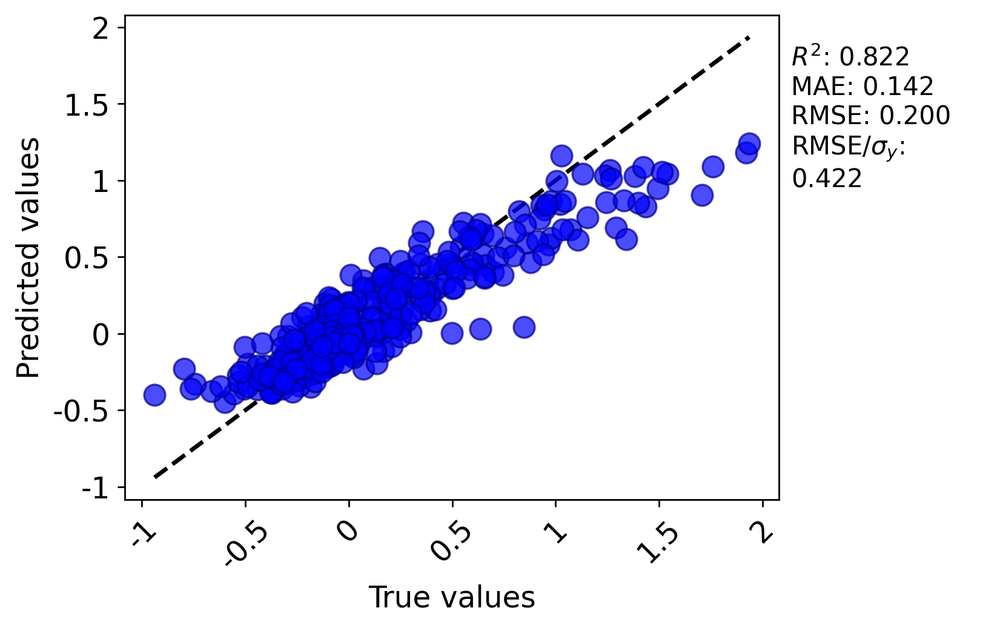

My previous result of leave out Pt RMSE was 0.277 eV. The nested CV left out data RMSEs are
0.172 eV for 5-fold and 0.200 eV for leave out group. It's evident that the leave out group
test is more closely aligned with the scale of error one should expect by predicting on a 
new group, and the prediction of Pt seems to be a rather difficult one, considering its 
error is even higher than the nested leave out group score. This is consistent with what
we saw in Tutorial 4, where the Pt RMSE was among the highest of all the groups from the
RMSE vs group plot.

## Task 5.3: Optimize the hyperparameters of our models to create the best model <a name="task53"></a>

Let's go back to our dataset from the first task where we leave out Pt and
include hyperparameter optimization for our kernel ridge model. To keep the runs reasonably fast, 
we are only going to optimize the alpha parameter in Kernel ridge, which is the regularization strength.
This optimization will be done for each train/test split in the random
5-fold cross validation stage. Then, the best model will be selected and used to predict the
left out Pt data. 

The parameters for hyperparameter optimization routines have a defined structure. The parameter
names need to be separated by semicolons (see below commented part for designating alpha, gamma,
and kernel type). The parameter values are also delimited by semicolons (one set per parameter).
For designating the grid of values to explore, the first number is the lower bound, the second
number is the upper bound, the third number is grid density, and the fourth value is "lin" or 
"log" to denote linear or logarithmic scale, respectively. The final value is the data type of the
parameter.

In [8]:
model_krr = SklearnModel(model='KernelRidge', kernel='rbf')
preprocessor = SklearnPreprocessor(preprocessor='StandardScaler', as_frame=True)
metrics = ['r2_score', 'mean_absolute_error', 'root_mean_squared_error', 'rmse_over_stdev']

hyperopt = GridSearch(param_names='alpha',
                     param_values='-5 5 100 log float',
                     scoring='root_mean_squared_error')

splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_krr],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  hyperopts=[hyperopt],
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  leaveout_inds=X_testdata,
                  verbosity=3)

Below is an example of optimizing three parameters in the Kernel ridge model. We don't run it here
because it will take a long time

hyperopt = GridSearch(param_names='alpha ; gamma ; kernel',
        param_values='-5 5 100 log float ; -5 5 100 log float ; linear rbf sigmoid str',
        scoring='root_mean_squared_error')



MAST-ML performs hyperparameter optimization for each train/test split, yielding an optimized model
for each training set. Within the split directory, a spreadsheet containing the best model parameters
and the cross validation scores for each set of parameters are saved:

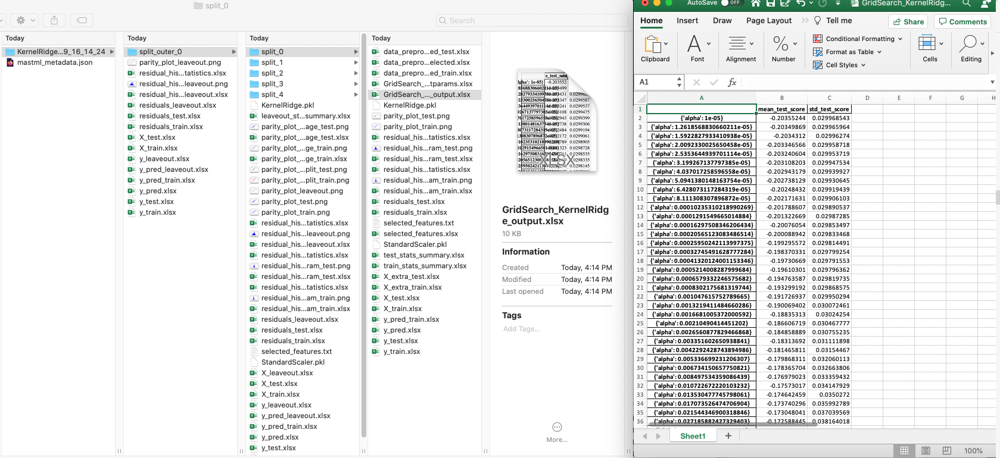

How does this model perform on the Pt data compared to the one we ran above? When just using the
non-optimized Kernel ridge model, I got an RMSE of 0.277 eV. 

### Pt left out data parity plot (not optimized):
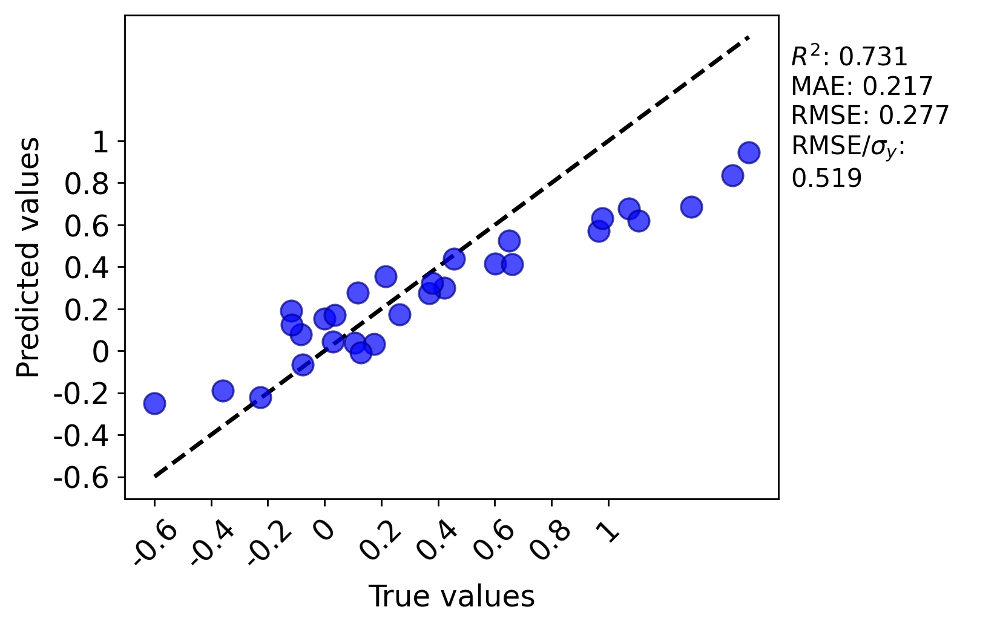

### Pt left out data parity plot (optimized):
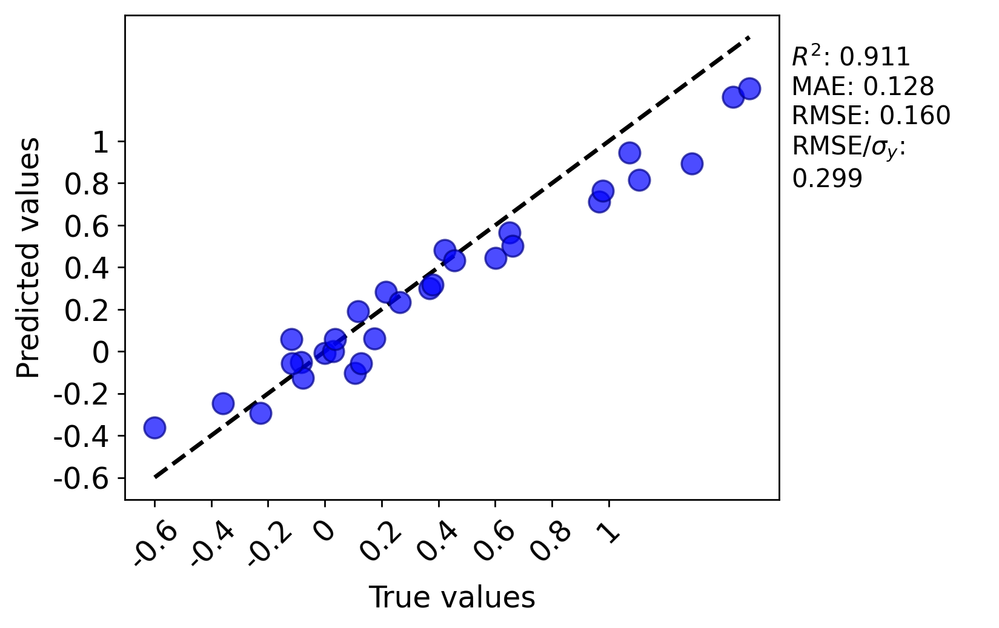

After optimizing just the alpha parameter, the RMSE on the Pt data has dropped to just 0.160 eV!

Let's try another form of hyperparameter optimization. Instead of performing
a grid search, we are going to do a randomized search. We will search
over two variables this time: alpha and gamma. Instead of specifying a range
of values to examine, the param_values need to be probability distributions
from the scipy.stats module. Here, we have just used uniform distributions.
One could also specify a normal distribution, exponential or sinusoidal distribution, etc.
The n_iter tag affects convergence and needs to be high enough such that the optimal
parameter values are found for a given split.

In [9]:
hyperopt = RandomizedSearch(param_names='alpha ; gamma',
                            param_values='uniform ; uniform',
                            scoring='root_mean_squared_error',
                            n_iter=100)

splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_krr],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  hyperopts=[hyperopt],
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  leaveout_inds=X_testdata,
                  verbosity=3)

The following is one more example of performing a grid search, this time using an
MLPRegressor model. This model is a bit unique in that one of its key inputs
is a tuple, not just a string or number. There is a designated format for handling
a grid search of a set of tuples, which is shown below. In param_values, we have
5 different neural network architectures. The grid search will try each one and
assess which is best.

In [ ]:
model_nn = SklearnModel(model='MLPRegressor', hidden_layer_sizes=(20,))
preprocessor = SklearnPreprocessor(preprocessor='StandardScaler', as_frame=True)
metrics = ['r2_score', 'mean_absolute_error', 'root_mean_squared_error', 'rmse_over_stdev']

hyperopt = GridSearch(param_names='hidden_layer_sizes',
                     param_values='(20,) (20,10) (10,5) (10,) (20,10,5) tup',
                     scoring='root_mean_squared_error')

splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_nn],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  hyperopts=[hyperopt],
                  plots=['Scatter', 'Histogram'],
                  savepath=savepath,
                  X_extra=X_extra,
                  leaveout_inds=X_testdata,
                  verbosity=3)

With everything we've covered here, you could combine nested CV with the hyperparameter optimization
to obtain a more realistic best-case fit model for both the random CV and leave out group CV
tests. This exercise is quite time consuming and will be part of a designated tutorial notebook
which takes the user from the end-to-end process of building, evaluating and using ML models

You've now completed your fifth MAST-ML tutorial notebook! Now that you're more familiar with performing detailed
model evaluation with nested cross validation and creating optimized models, it is time to move to one of the final
tutorials in this series, and a subject of great importance when evaluating the efficacy of ML models: predictions
of model errors, domains, and uncertainty quantification (UQ).

The next example in this notebook series is titled MASTML_Tutorial_6_ErrorAnalysis_UncertaintyQuantification.ipynb, 
and will guide you through the process assessing the true and predicted errors of some models on a select dataset
and detail methods to recalibrate the model uncertainty estimates to more accurately reflect the true model errors.

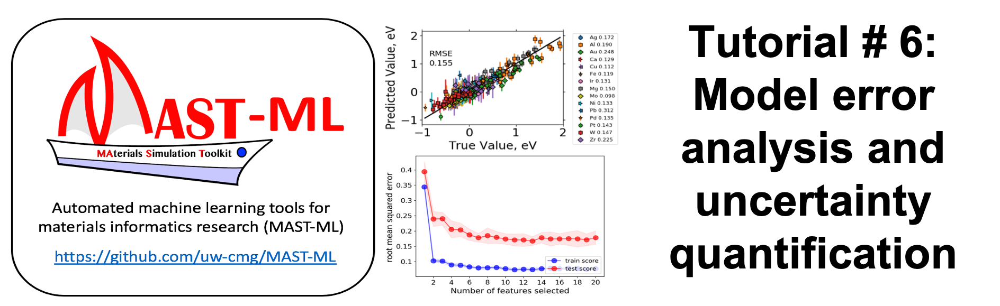

# Tutorial 6: Model error analysis and uncertainty quantification with MAST-ML<a name="tutorial6"></a> 

## In this tutorial, we will learn about how MAST-ML can be used to:

6.1. [Assess the true and predicted errors of our model, and some useful measures of their statistical distributions](#task61)

6.2. [Explore different methods of quantifying and calibrating model uncertainties](#task62)

6.3. [Compare the uncertainty quantification behavior of Bayesian and ensemble-based models](#task63)


Here we import the MAST-ML modules used in this tutorial

In [1]:
from mastml.mastml import Mastml
from mastml.datasets import LocalDatasets
from mastml.preprocessing import SklearnPreprocessor
from mastml.models import SklearnModel
from mastml.data_splitters import SklearnDataSplitter
import mastml
import os
data_path = os.path.join(mastml.__path__._path[0], 'data')

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


Figshare is an optional dependency. To import data from figshare, manually install figshare via git clone of git clone https://github.com/cognoma/figshare.git


Failed to import duecredit due to No module named 'duecredit'


Here, we set the name of the savepath to save MAST-ML results to, and initialize
our MAST-ML run

When the above command is run, a new folder with the name designated SAVEPATH is created.
This is where all of the output for the current MAST-ML run will be saved to.
Note that you can perform multiple runs with the same folder name, and the current datetime
will be appended to the name so that no data is lost or overwritten.

In [2]:
SAVEPATH = 'drive/MyDrive/MASTML_tutorial_6_ErrorAnalysis_UncertaintyQuantification'

mastml = Mastml(savepath=SAVEPATH)
savepath = mastml.get_savepath

## Task 6.1: Assess the true and predicted errors of our model, and some useful measures of their statistical distributions <a name="task61"></a>

In this tutorial, we will again use the diffusion dataset that we examined in the 
previous tutorial. Here, we use the LocalDatasets module to load in the diffusion dataset. 

In [4]:
target = 'E_regression'

extra_columns = ['Material compositions 1', 'Material compositions 2']

d = LocalDatasets(file_path=data_path+'/diffusion_data_selectfeatures.xlsx', 
                  target=target, 
                  extra_columns=extra_columns, 
                  group_column='Material compositions 1',
                  testdata_columns=None,
                  as_frame=True)

# Load the data with the load_data() method
data_dict = d.load_data()

# Let's assign each data object to its respective name
X = data_dict['X']
y = data_dict['y']
X_extra = data_dict['X_extra']
groups = data_dict['groups']
X_testdata = data_dict['X_testdata']

Only certain types of ML models can be used to establish predicted errors: they consist of Bayesian methods,
namely Gaussian Process Regression, and Ensemble methods, such as random forest, gradient boosting regression,
or the general EnsembleModel() object we explored in Tutorial 4.

Here, we are going to begin by using a random forest model. To perform the error analysis, we designate "Error"
in the plots field (you can also add "Scatter" and "Histogram" to make the parity plots and histograms we've been
analyzing in previous tutorials, but they are removed here for simplicity). Secondly, we can specify the error
analysis method (pertains to ensemble methods only). Here, we are using "stdev_weak_learners". What this method
does is calculates the error bar on each data point as the standard deviation of each weak learner prediction. In
the context of random forest, each decision tree predicts the value of a data point: the average is the predicted
value, and the standard deviation on that value is the error bar.

To examine model errors in detail, it is best to perform many instances of nested cross validation. In this tutorial,
we will just do one repeat of 5-fold CV to keep the calculation time short.

In [5]:
preprocessor = SklearnPreprocessor(preprocessor='StandardScaler', as_frame=True)

model_rf = SklearnModel(model='RandomForestRegressor', n_estimators=150)

metrics = ['r2_score', 'mean_absolute_error', 'root_mean_squared_error', 'rmse_over_stdev']

splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)

splitter.evaluate(X=X,
                  y=y, 
                  models=[model_rf],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Error'],
                  savepath=savepath,
                  X_extra=X_extra,
                  nested_CV=True,
                  error_method='stdev_weak_learners', 
                  verbosity=3)

There are four main types of error plots that MAST-ML produces that are worth examining in more detail:

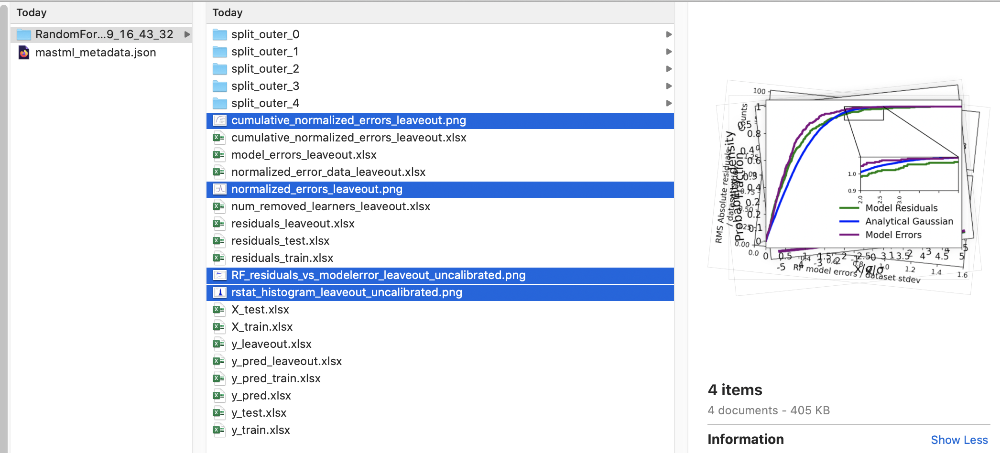

### The "r-statistic" plot:
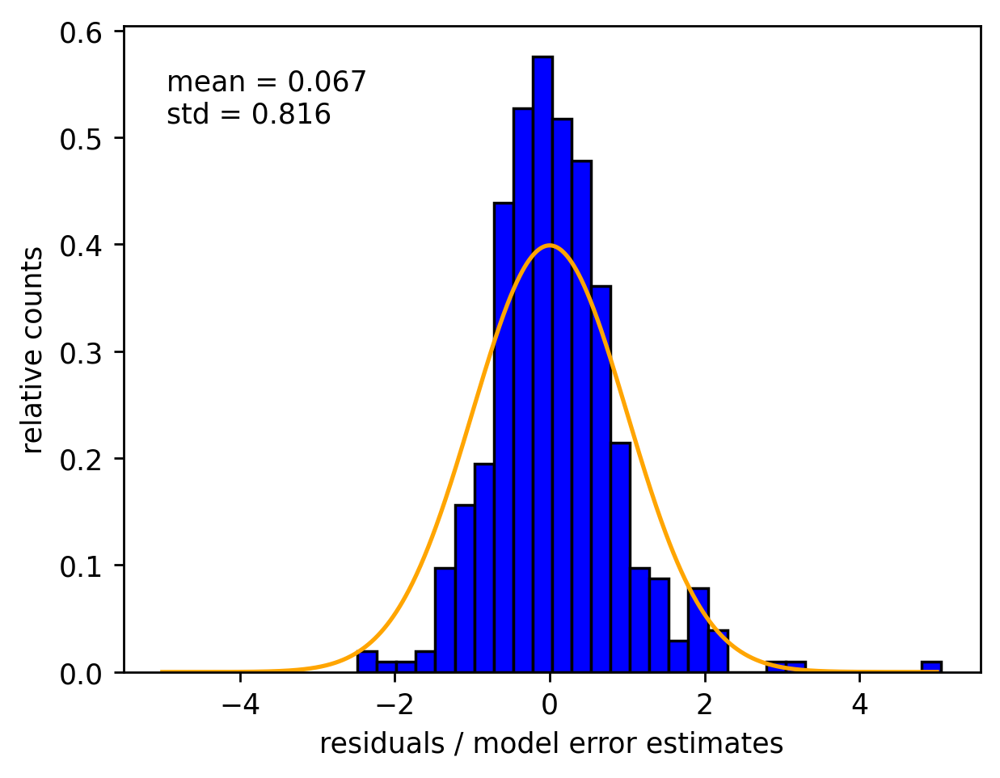

This plot histograms a value we have come to call the "r-statistic", it is a reduced error value which is defined here as the true model error (residuals) divided by the predicted model error (error bars). If the model error estimates are good estimates of the true error, this distribution should be normal with mean zero and standard 
deviation of one. We can see that the standard deviation is less than one here- we will discuss the implications of this more below.

### The normalized error distribution plot:
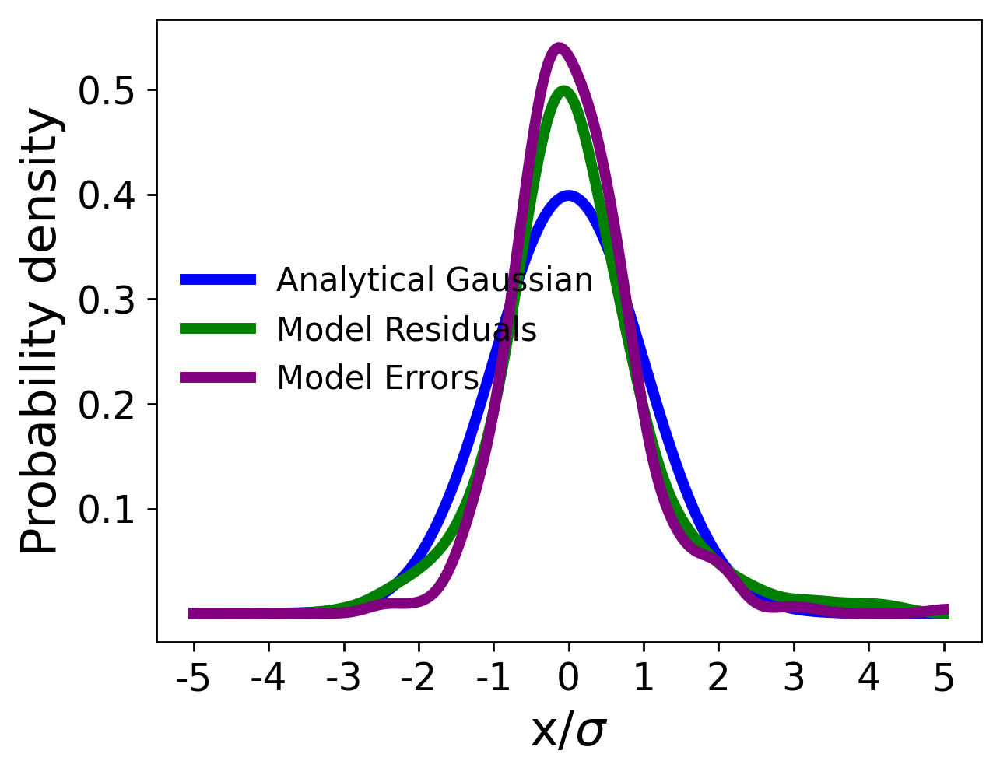

This plot is similar to the r-statistic plot in that it shows the distribution of the r-statistic values (in purple). Instead of a histogram a smooth distribution is made. Also shown are a normal distribution (in blue), and the distribution of normalized residuals (in green). The normalized residuals are calculated as residuals divided by the dataset standard deviation. We can see the purple distribution is skinnier than the normal distribution, consistent with the r-statistic having standard deviation less than one.

### Cumulative normalized error distribution:
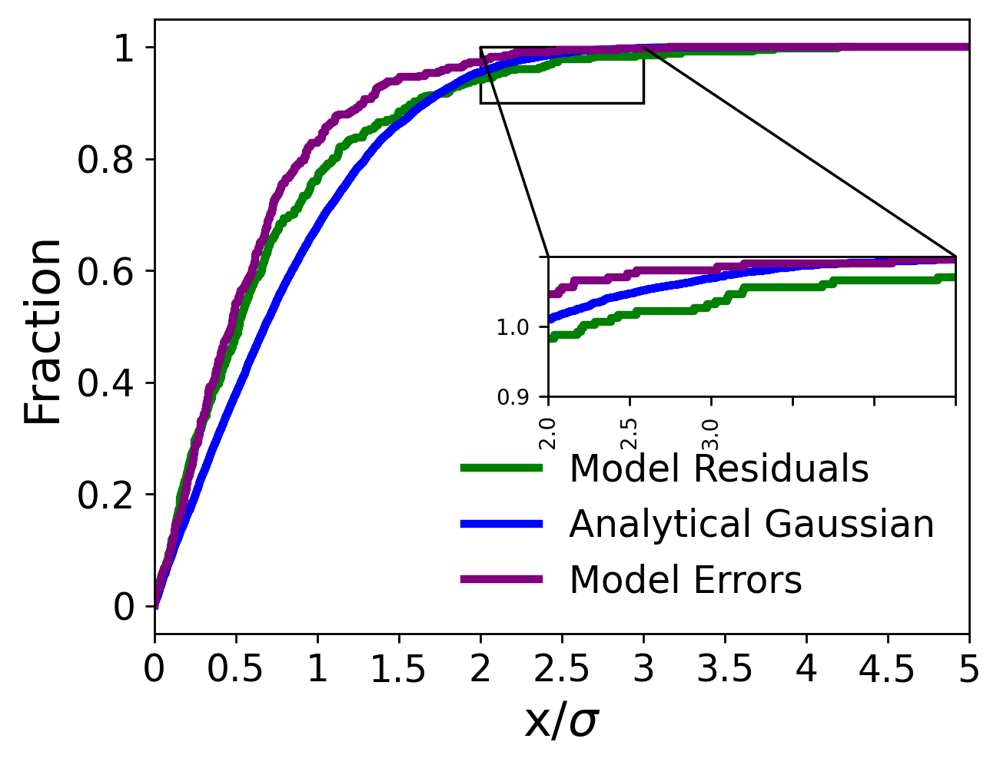

This plot contains the same data as the normalized error distribution, except it is now plotted in as a cumulative distribution (i.e. all curves will converge to 1 as the reduced error x/sigma increases). Once again, the normal distribution is in blue, the normalized residuals distribution is in green, and the r-statistic (normalized model errors) are in purple. Both the green and purple curves lie to the left of the normal distribution, indicating that the denominator of x/sigma (for purple, the model error bars) are too large, i.e. the model is overestimating the true error.


### Residuals vs. Error (RvE) plot:
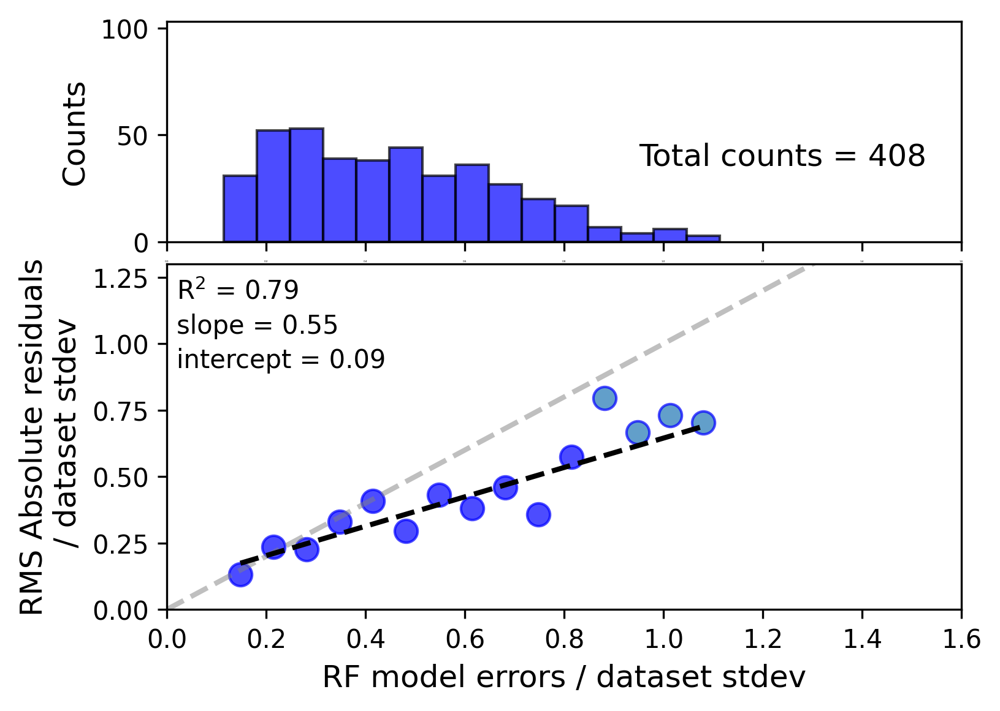

My personal favorite. The residual vs. error plot takes the data shown in the r-statistic distribution and shows how the true errors (residuals) actually correlate with the respective predicted errors. The y-axis are the true errors (residuals) grouped into a finite number of bins. Each data point is the root mean squared residual of that particular bin. The x-axis are the predicted errors. Both axes are normalized by the dataset standard deviation, so they are unitless. The histogram on the top shows the distribution of data points present in each bin. The y=x identity line is plotted. Ideally, you want the data points to fall on this line, because it means the model predicted errors are exactly what you expect based on the true errors. A weighted linear fit (black dashed line) is made to the plotted data. In this case the trend is linear, but the slope is less than one and the intercept is not zero. This indicates that the model is overestimating the true error of the data points, which is also why the r-statistic distribution had a standard deviation less than one. Below, we will see how we can use the method of Palmer, Jacobs and Morgan to recalibrate these uncertainty estimates to more closely align with the true values.

Let's do the run again but this time enable recalibration of errors based on the method of Palmer et al. This is switched on using recalibrate_errors = True

In [ ]:
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_rf],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Error'],
                  savepath=savepath,
                  X_extra=X_extra,
                  nested_CV=True,
                  error_method='stdev_weak_learners', 
                  recalibrate_errors=True,
                  verbosity=3)

When error recalibration is enabled, r-statistic and RvE plots are made for both uncalibrated and calibrated data. In addition, summary plots with both cases superposed are produced, as shown here:

### r-statistic plot with and without calibration
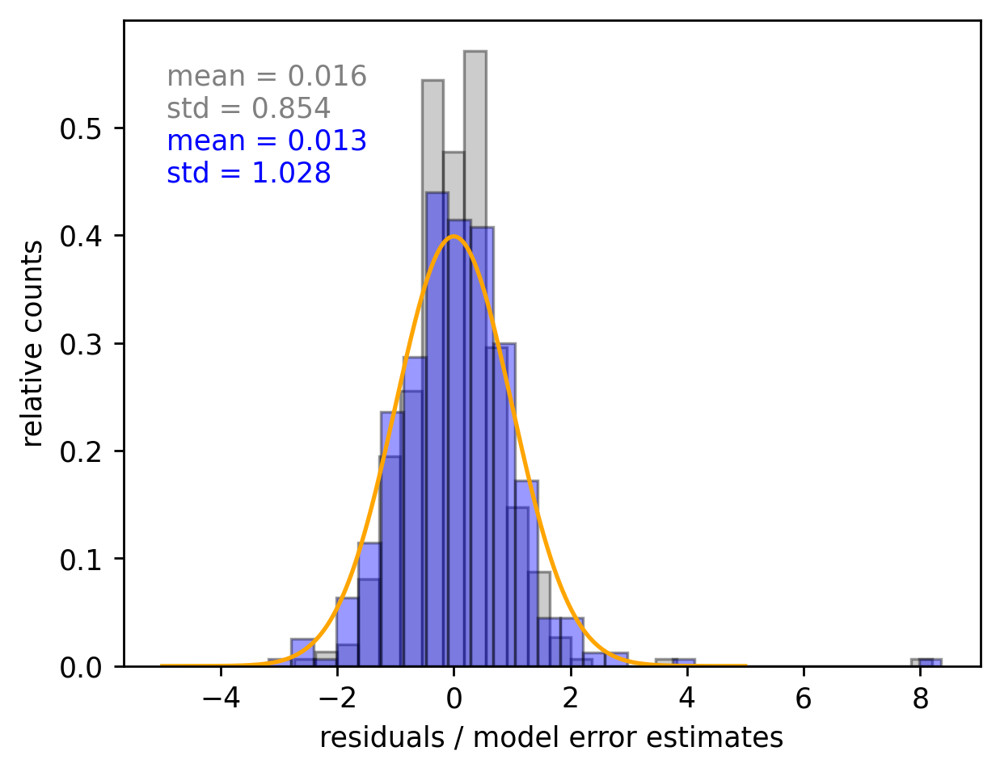

### Residual vs. error plot with and without calibration
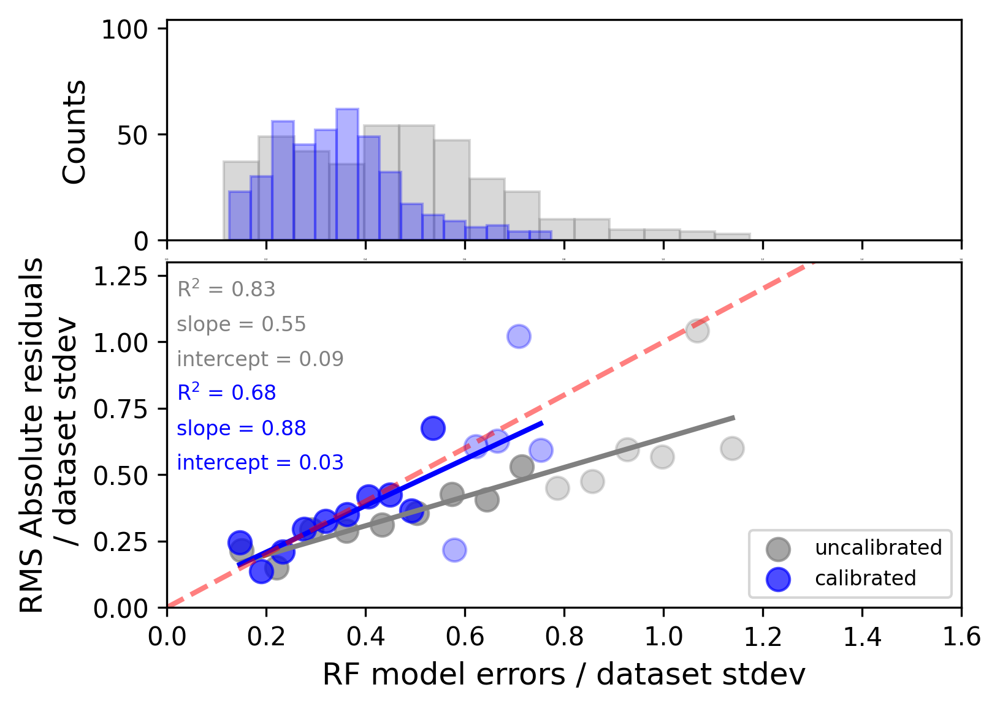

A few things become apparent by examining these figures. From the r-statistic plot, we can see that recalibration results in a mean closer to zero and standard deviation closer to one compared to the uncalibrated case. From the residual vs. error plot, the slope of the fitted line is closer to one (0.88 vs 0.55). In this particular case, the intercept is no closer to zero and the R-squared value has decreased a bit. These effects are due to small sample size. If you have the patience to re-do this run but with n_repeats=5 (total of 625 nested CV splits), the data will look even better and show robust linear correlation for the calibrated case. Overall, the recalibration has improved the model error estimates!

## Task 6.2: Explore different methods of quantifying and calibrating model uncertainties <a name="task62"></a>

In addition to the method of Palmer et al. to recalibrate the model uncertainty estimates, a
well-known method called "jackknife after bootstrap" developed by Efron, Wager, and colleagues
is also popular. We can compare how this method performs with that of Palmer et al. by switching
the error_method parameter to be "jackknife_after_bootstrap"

In [ ]:
splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_rf],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Error'],
                  savepath=savepath,
                  X_extra=X_extra,
                  nested_CV=True,
                  error_method='jackknife_after_bootstrap', 
                  recalibrate_errors=True,
                  verbosity=3)

### r-statistic plot with and without calibration (jackknife after bootstrap)
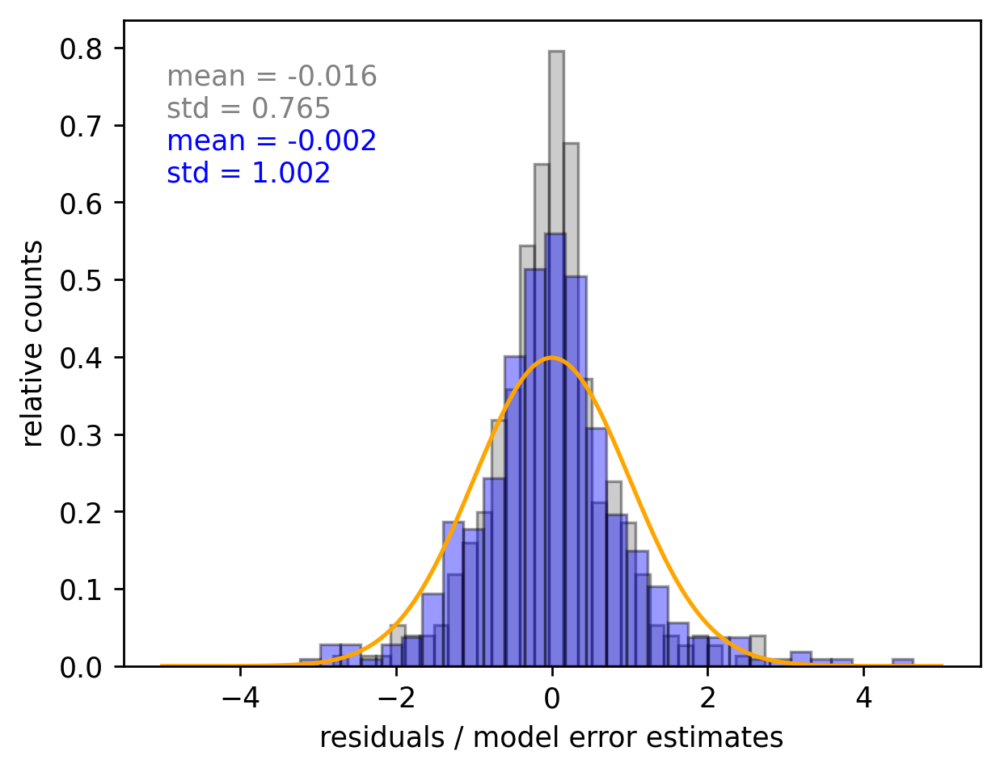

### Residual vs. error plot with and without calibration (jackknife after bootstrap)
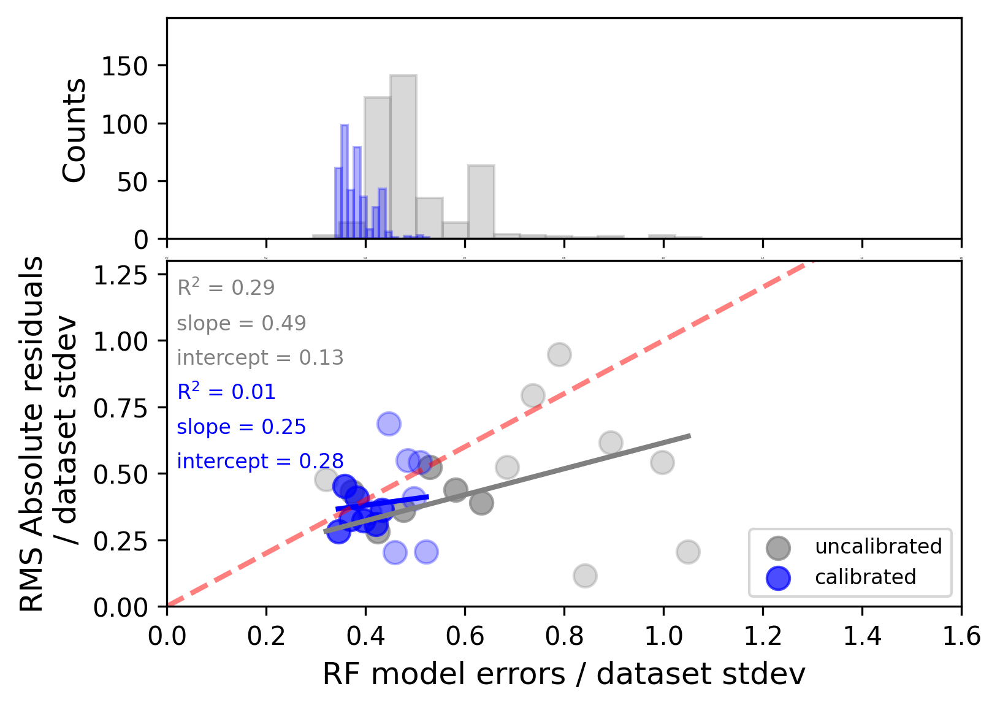

From inspecting these plots and comparing them with the above plots obtained using standard deviation of weak learners, we can see that, for this particular dataset and CV test at least, that using jackknife after bootstrap to obtain error estimates results in worse approximation of the true errors than if the standard deviation of weak learners is used. Application of the recalibration method of Palmer et al. helps a bit to correct for this, but the estimates are still worse than those shown above. One thing that is interesting is that the recalibration method makes the r-statistic plot look basically perfect. However, once you examine the correlation between the true and predicted errors in the RvE plot, it is much less clear how good of an error estimation we actually have!

## Task 6.3: Compare the uncertainty quantification behavior of Bayesian and ensemble-based models <a name="task63"></a>

Besides ensemble methods, Bayesian methods offer a direct means to obtain an error bar for each predicted data point. Here, we examine the behavior of the error bars obtained for Gaussian Process Regression and compare them to the behavior of the random forest models we looked at above

In [ ]:
model_gpr = SklearnModel(model='GaussianProcessRegressor', kernel='ConstantKernel*RBF', n_restarts_optimizer=10)

splitter = SklearnDataSplitter(splitter='RepeatedKFold', n_repeats=1, n_splits=5)
splitter.evaluate(X=X,
                  y=y, 
                  models=[model_gpr],
                  mastml=mastml,
                  preprocessor=preprocessor,
                  metrics=metrics,
                  plots=['Error'],
                  savepath=savepath,
                  X_extra=X_extra,
                  nested_CV=True,
                  recalibrate_errors=True,
                  verbosity=3)

### r-statistic plot (GPR)
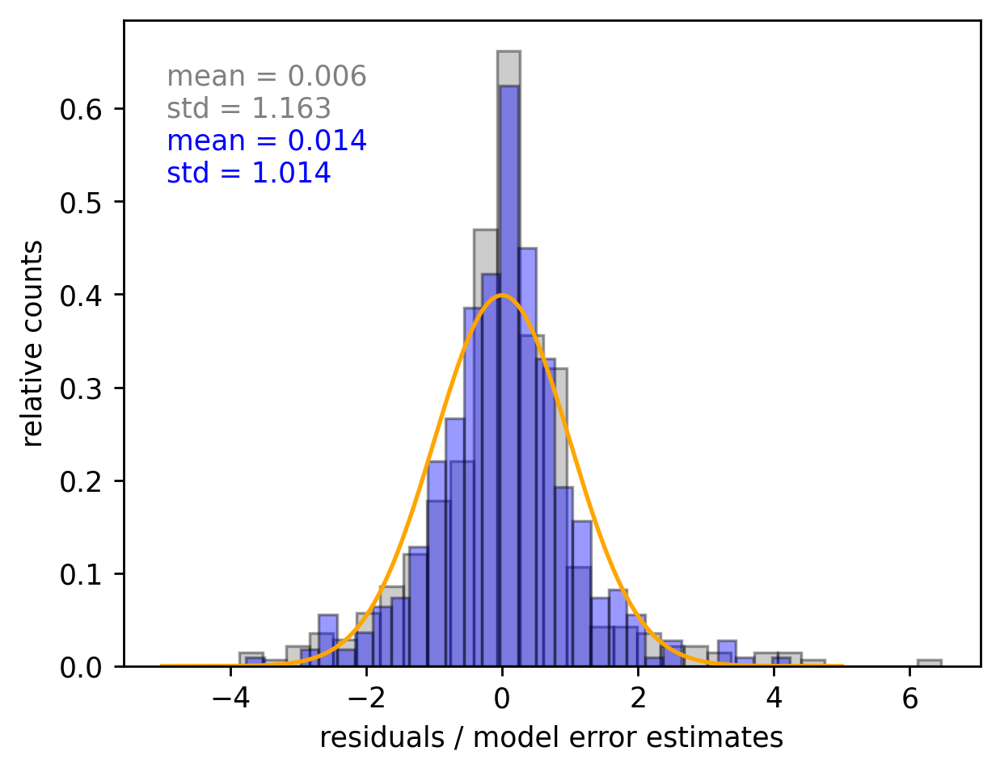

### Residual vs. error plot (GPR)
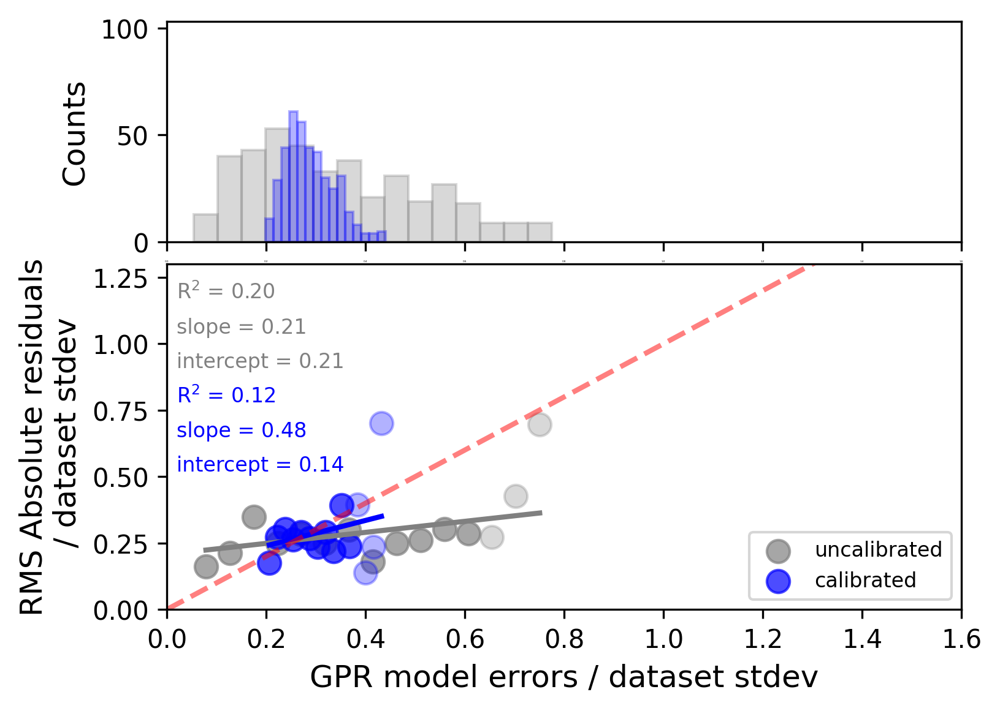

For the case of GPR, the r-statistic plot prior to calibration has a standard deviation greater than one. Contrary to the random forest case, this indicates that GPR is tending to underestimate the true error. After calibration, the standard deviation is very close to one. 

For the residual vs. error plot, regardless if the data are calibrated or not, there is almost no correlation between the true and predicted errors. One interesting thing we have found, but won't do here as it is very computationally expensive, is that if you build an ensemble of GPR models, you will find, at least for this dataset, highly linear and well-correlated uncertainty estimates!

You've now completed your sixth MAST-ML tutorial notebook! You have reached the end of the current MAST-ML
tutorial series. 

Future tutorials will focus on model upload and dissemination to the DLHub model hosting infrastructure, and using hosted models to make predictions on new data
